In [1]:
#Load CSV → Display Structure → Datatypes

import pandas as pd

agri_df = pd.read_csv(r"C:\Jeeva\Course\csv_file\agri_capstone.csv")
agri_df.head()

,Dist Code,Year,State Code,State Name,Dist Name,RICE AREA (1000 ha),RICE PRODUCTION (1000 tons),RICE YIELD (Kg per ha),WHEAT AREA (1000 ha),WHEAT PRODUCTION (1000 tons),...,SUGARCANE YIELD (Kg per ha),COTTON AREA (1000 ha),COTTON PRODUCTION (1000 tons),COTTON YIELD (Kg per ha),FRUITS AREA (1000 ha),VEGETABLES AREA (1000 ha),FRUITS AND VEGETABLES AREA (1000 ha),POTATOES AREA (1000 ha),ONION AREA (1000 ha),FODDER AREA (1000 ha)
0,1,1966,14,Chhattisgarh,Durg,548.0,185.0,337.59,44.0,20.0,...,1777.78,0.0,0.0,0.0,5.95,6.64,12.59,0.01,0.60,0.47
1,1,1967,14,Chhattisgarh,Durg,547.0,409.0,747.71,50.0,26.0,...,1500.00,0.0,0.0,0.0,5.77,7.24,13.02,0.01,0.56,1.23
2,1,1968,14,Chhattisgarh,Durg,556.3,468.0,841.27,53.7,30.0,...,1000.00,0.0,0.0,0.0,5.41,7.40,12.81,0.10,0.58,1.02
3,1,1969,14,Chhattisgarh,Durg,563.4,400.8,711.40,49.4,26.5,...,1900.00,0.0,0.0,0.0,5.52,7.16,12.69,0.01,0.56,0.84
4,1,1970,14,Chhattisgarh,Durg,571.6,473.6,828.55,44.2,29.0,...,2000.00,0.0,0.0,0.0,5.45,7.19,12.64,0.02,0.52,0.42


In [3]:
#find columns info
agri_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16146 entries, 0 to 16145
Data columns (total 80 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Dist Code                                    16146 non-null  int64  
 1   Year                                         16146 non-null  int64  
 2   State Code                                   16146 non-null  int64  
 3   State Name                                   16146 non-null  object 
 4   Dist Name                                    16146 non-null  object 
 5   RICE AREA (1000 ha)                          16146 non-null  float64
 6   RICE PRODUCTION (1000 tons)                  16146 non-null  float64
 7   RICE YIELD (Kg per ha)                       16146 non-null  float64
 8   WHEAT AREA (1000 ha)                         16146 non-null  float64
 9   WHEAT PRODUCTION (1000 tons)                 16146 non-null  float64
 10

In [5]:
# 1. Data Types Identification
categorical_cols = agri_df.select_dtypes(include=['object']).columns.tolist()
numerical_cols = agri_df.select_dtypes(include=['int64', 'float64']).columns.tolist()
datetime_cols = agri_df.select_dtypes(include=['datetime64']).columns.tolist()

print("Categorical Columns:", len(categorical_cols), categorical_cols)
print("Numerical Columns:", len(numerical_cols))
print("DateTime Columns:", len(datetime_cols))

Categorical Columns: 2 ['State Name', 'Dist Name']
Numerical Columns: 78
DateTime Columns: 0


In [7]:
# 2. Missing Values Percentage
missing_percentage = (agri_df.isnull().sum() / len(agri_df)) * 100
missing_percentage = missing_percentage[missing_percentage > 0]  # Only showing columns with missing values

print("Missing Values Percentage:")
print(missing_percentage)

Missing Values Percentage:
Series([], dtype: float64)


In [9]:
# Find all duplicate rows (excluding the first occurrence)
duplicate_rows = agri_df[agri_df.duplicated()]

# Count total duplicate rows
total_duplicates = duplicate_rows.shape[0]

print("Total Duplicate Rows:", total_duplicates)


Total Duplicate Rows: 0


In [11]:
# Phase 2: Univariate Analysis
# Numerical Columns Distribution

# Measure statistics: Mean, Median, Mode, Min, Max, Standard Deviation.
# Plot histogram for distribution visualization.

agri_df.describe()

,Dist Code,Year,State Code,RICE AREA (1000 ha),RICE PRODUCTION (1000 tons),RICE YIELD (Kg per ha),WHEAT AREA (1000 ha),WHEAT PRODUCTION (1000 tons),WHEAT YIELD (Kg per ha),KHARIF SORGHUM AREA (1000 ha),...,SUGARCANE YIELD (Kg per ha),COTTON AREA (1000 ha),COTTON PRODUCTION (1000 tons),COTTON YIELD (Kg per ha),FRUITS AREA (1000 ha),VEGETABLES AREA (1000 ha),FRUITS AND VEGETABLES AREA (1000 ha),POTATOES AREA (1000 ha),ONION AREA (1000 ha),FODDER AREA (1000 ha)
count,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,...,16146.00000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000,16146.000000
mean,269.769231,1991.496841,9.568562,128.593192,224.889565,1486.924784,77.057946,182.012746,1492.419859,22.632268,...,4500.15306,28.018367,7.229225,124.644823,7.750478,11.086250,18.677877,3.177038,1.194604,21.550328
std,278.309125,15.011185,4.988538,160.078825,326.629828,956.185281,100.394479,348.834254,1081.255367,45.062714,...,3153.97042,74.239648,25.042132,207.681147,13.591135,18.003257,25.881842,8.029509,4.285067,60.062601
min,1.000000,1966.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.00000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,78.000000,1978.000000,6.000000,10.400000,9.460000,800.000000,1.770000,2.000000,750.000000,0.000000,...,2000.00000,0.000000,0.000000,0.000000,0.310000,1.600000,2.520000,0.000000,0.060000,0.000000
50%,156.000000,1991.000000,10.000000,66.800000,95.840000,1333.210000,36.800000,42.700000,1347.450000,2.050000,...,4502.21000,0.050000,0.000000,0.000000,2.220000,4.740000,8.945000,0.390000,0.280000,1.200000
75%,241.000000,2005.000000,12.000000,191.390000,315.715000,2113.517500,123.000000,215.192500,2131.580000,20.900000,...,6704.60500,10.097500,2.000000,202.270000,8.790000,12.510000,23.570000,3.150000,0.880000,16.762500
max,917.000000,2017.000000,20.000000,1154.230000,3215.010000,5653.830000,879.490000,4305.500000,5541.520000,334.800000,...,22062.30000,800.890000,376.610000,5000.000000,159.540000,200.060000,240.990000,111.610000,131.350000,1162.660000


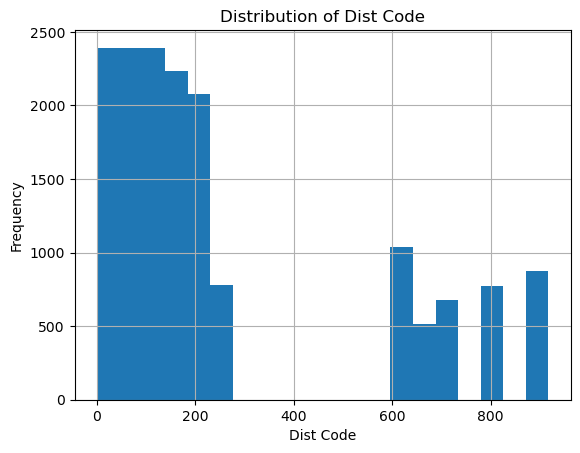

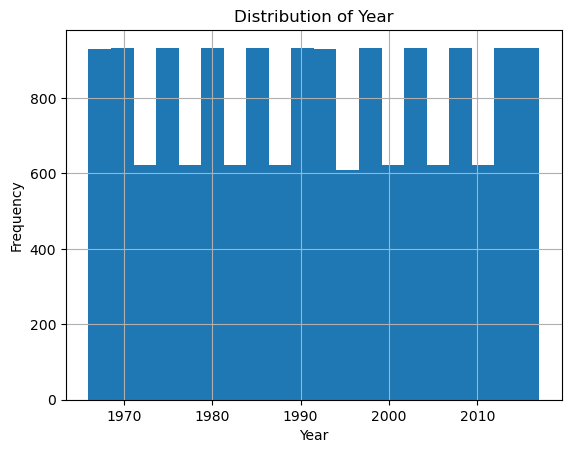

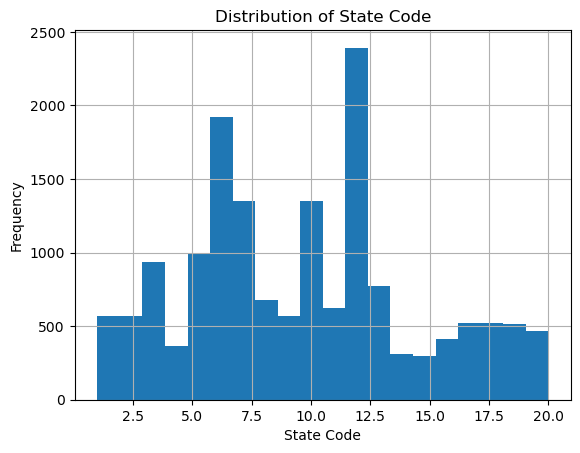

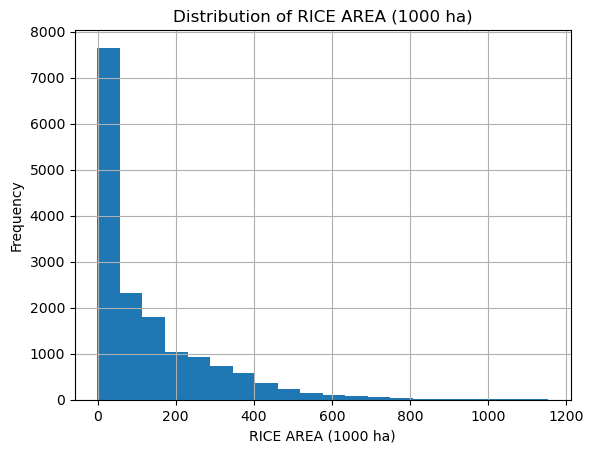

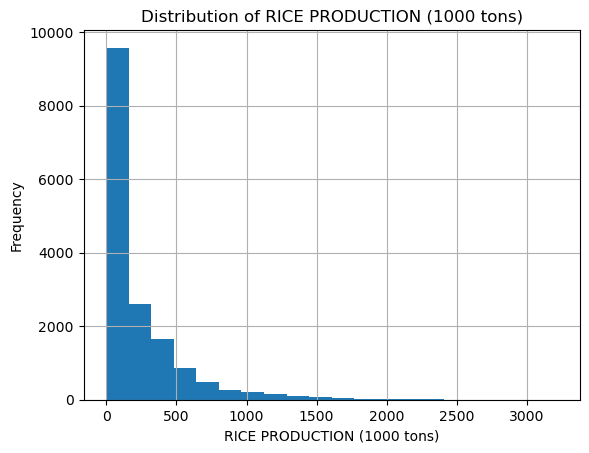

...

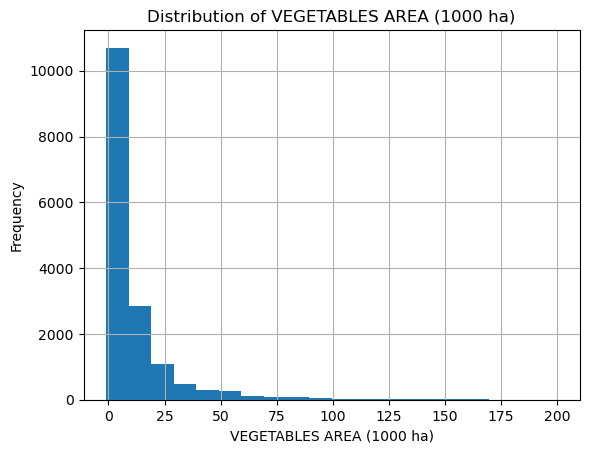

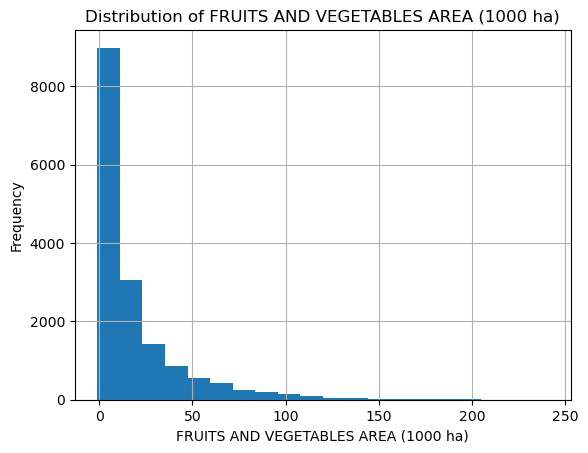

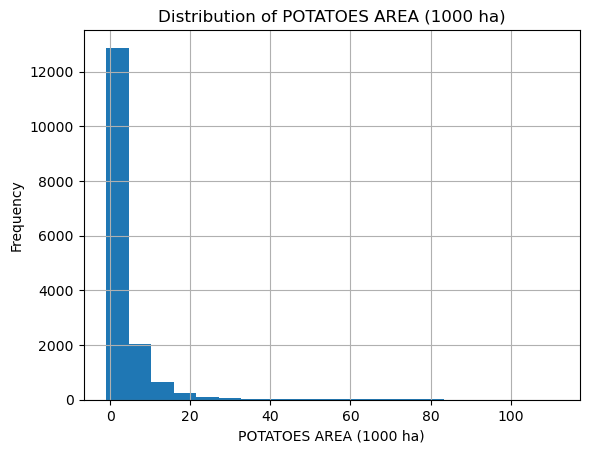

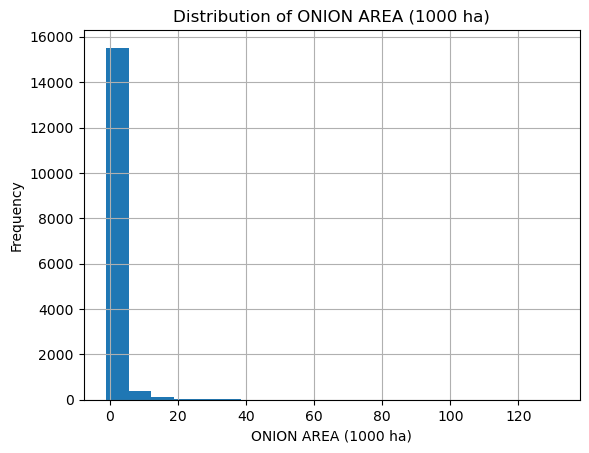

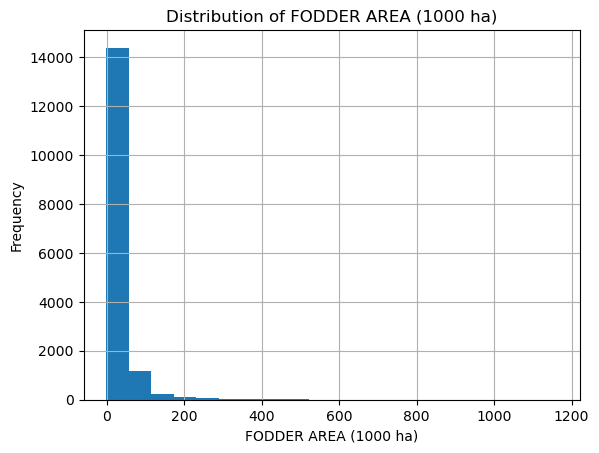

In [15]:
# Histograms (for numerical columns):
import matplotlib.pyplot as plt

numerical_cols = agri_df.select_dtypes(include=['int64', 'float64']).columns.tolist()

for col in numerical_cols:
    agri_df[col].hist(bins=20)  # Plot histogram for the column
    plt.title(f'Distribution of {col}')  # Set the title using the column name
    plt.xlabel(col)  # Label for x-axis
    plt.ylabel('Frequency')  # Label for y-axis
    plt.show()


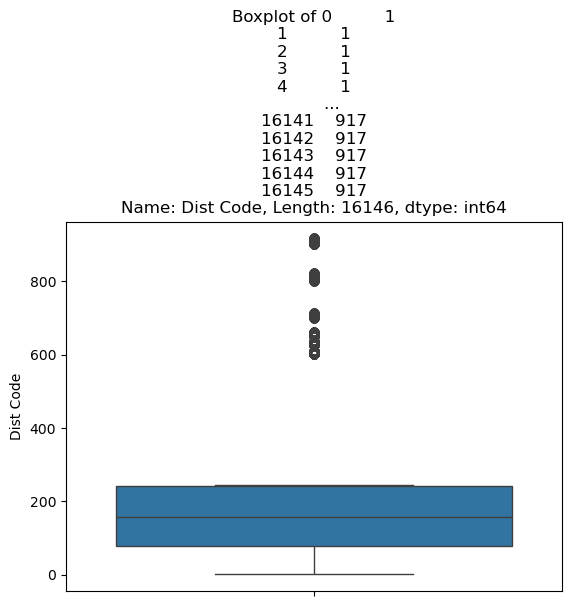

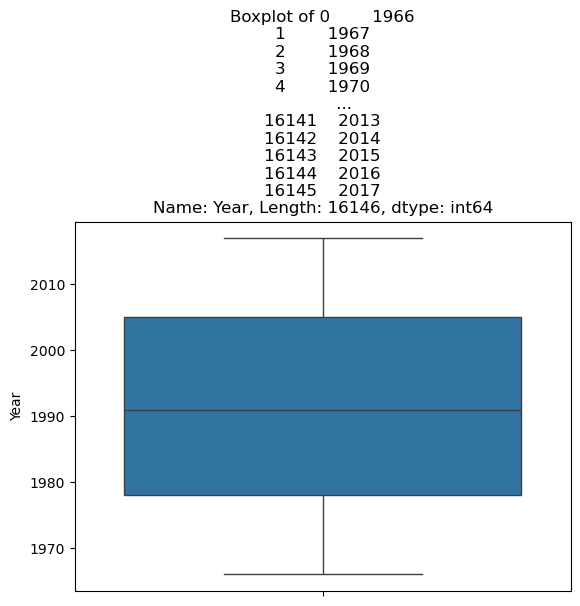

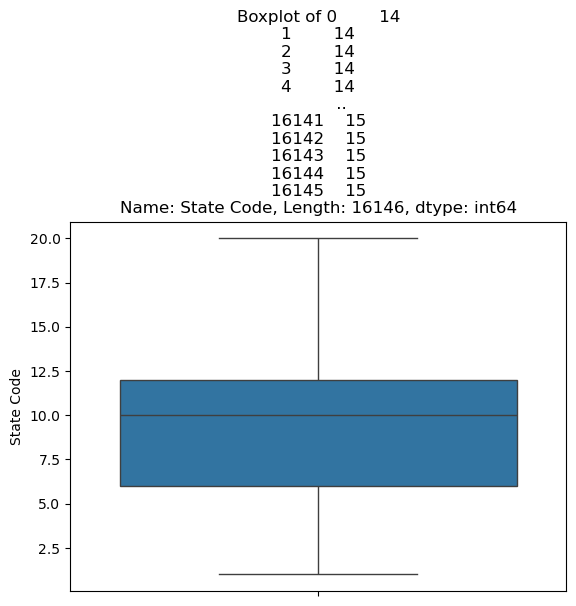

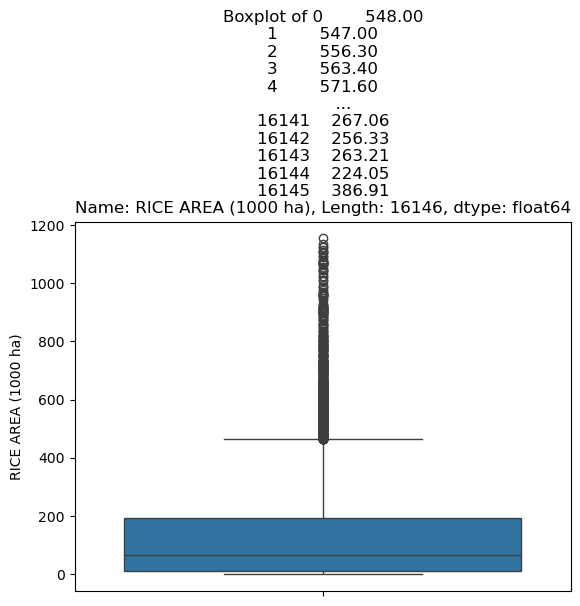

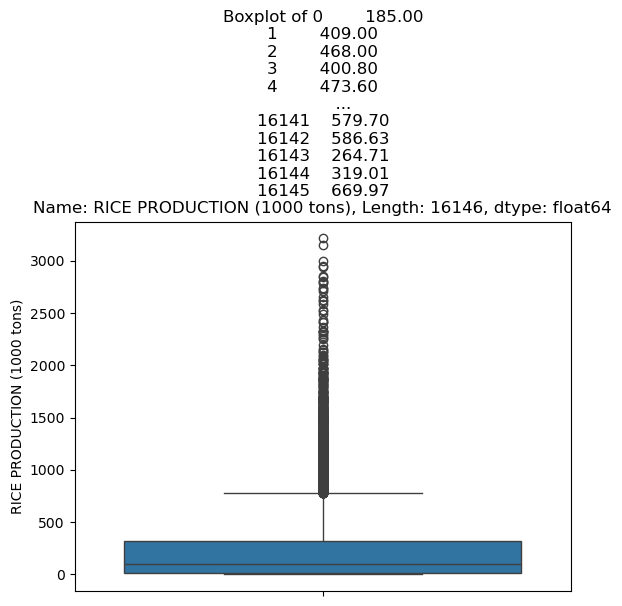

...

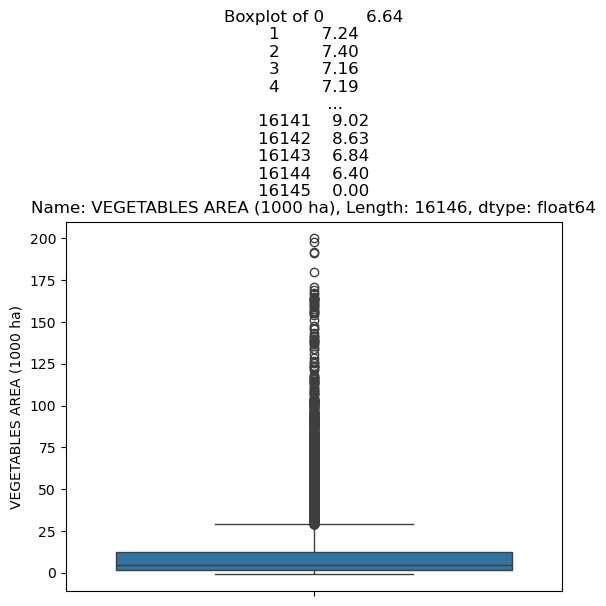

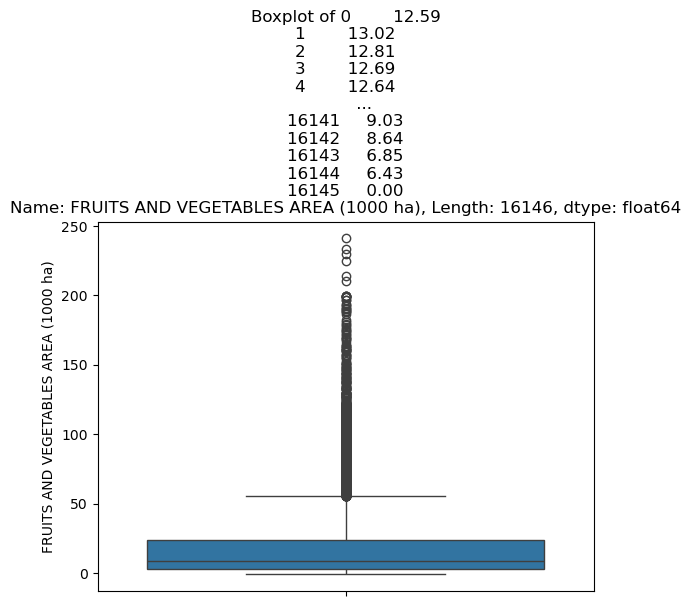

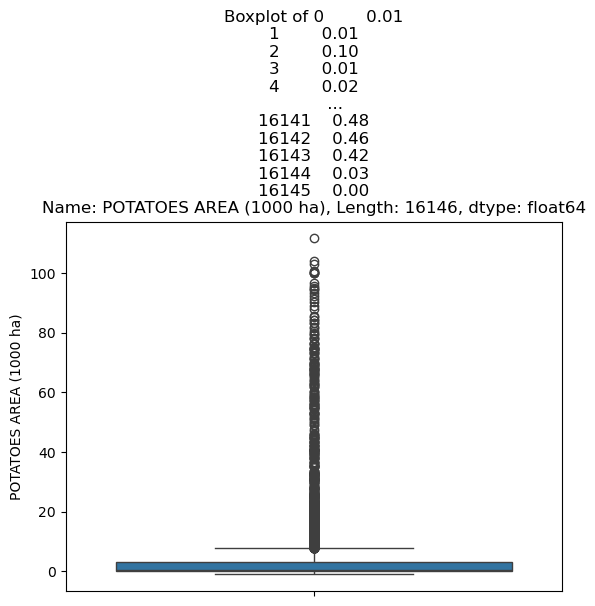

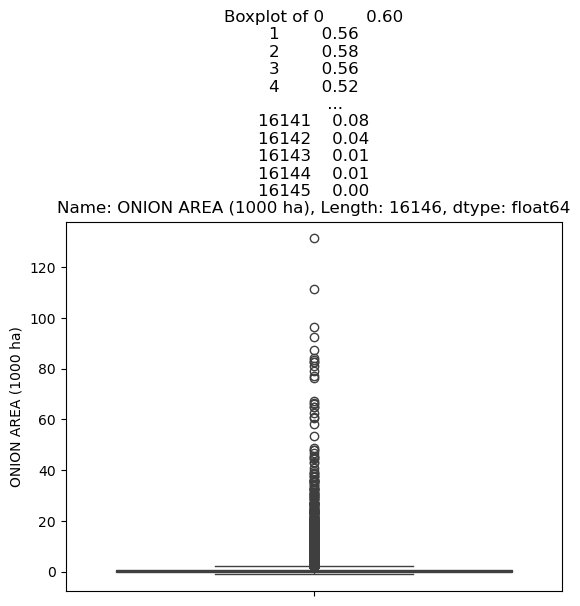

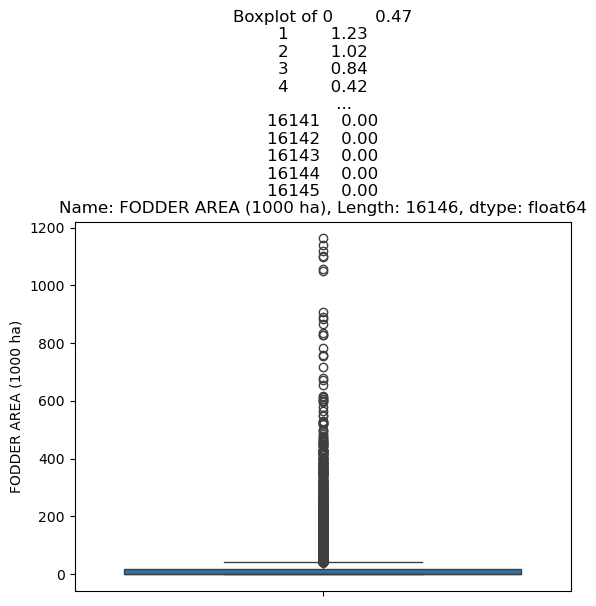

In [35]:
# Boxplots (for outlier detection):

import seaborn as sns
numerical_cols = agri_df.select_dtypes(include=['int64','float64']).columns.tolist()

for col in numerical_cols:
    sns.boxplot(agri_df[col])
    plt.title(f"Boxplot of {agri_df[col]}")
    plt.show()


In [17]:
#Value Counts (for categorical columns):

cat_columns = agri_df.select_dtypes(include=['int64','float64'])
for col in cat_columns:
    print(agri_df[col].value_counts())


Dist Code
1      52
208    52
216    52
215    52
214    52
       ..
917    50
910    50
657    48
95     48
822    46
Name: count, Length: 311, dtype: int64
Year
1986    311
1997    311
1988    311
1989    311
2012    311
2011    311
2010    311
2009    311
2008    311
1998    311
2007    311
1999    311
2000    311
2001    311
2002    311
2003    311
2004    311
2005    311
1987    311
2006    311
1985    311
1984    311
2016    311
1970    311
1971    311
1972    311
1973    311
1974    311
1975    311
1976    311
1977    311
1978    311
1979    311
1980    311
1981    311
1982    311
1983    311
2013    310
2014    310
2015    310
1966    310
1992    310
1994    310
1993    310
1967    310
1991    310
1990    310
1969    310
1968    310
2017    310
1996    305
1995    304
Name: count, dtype: int64
State Code
12    2392
6     1924
10    1352
7     1348
5      988
3      936
13     774
8      676
11     624
9      572
2      572
1      572
17     520
18     520
19     516
20     468

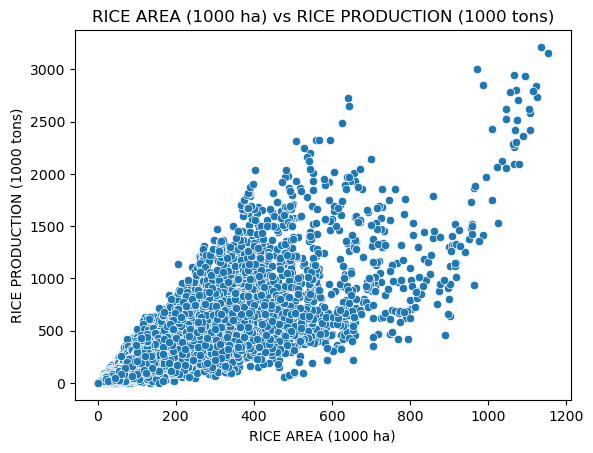

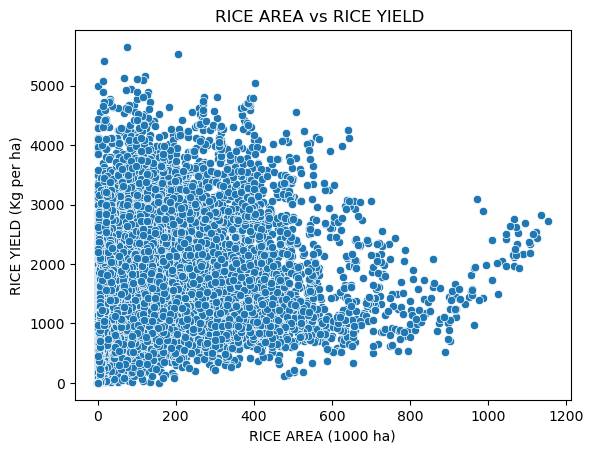

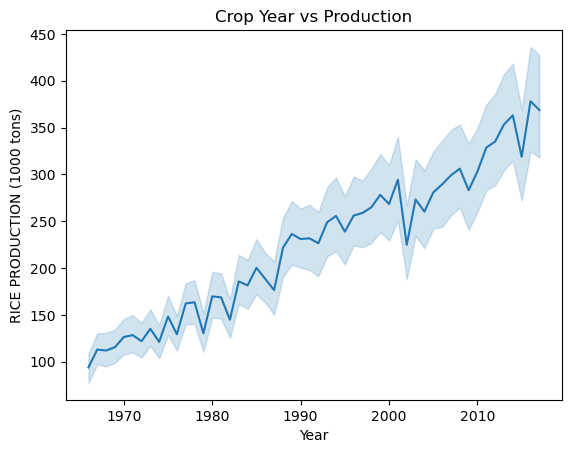

In [29]:
# Phase 3: Bivariate Analysis
import seaborn as sns

# Area vs Production
sns.scatterplot(data=agri_df, x='RICE AREA (1000 ha)', y='RICE PRODUCTION (1000 tons)')
plt.title("RICE AREA (1000 ha) vs RICE PRODUCTION (1000 tons)")
plt.show()

# Area vs Yield
sns.scatterplot(data=agri_df, x='RICE AREA (1000 ha)', y='RICE YIELD (Kg per ha)')
plt.title("RICE AREA vs RICE YIELD ")
plt.show()

# Year vs Production
sns.lineplot(data=agri_df, x='Year', y='RICE PRODUCTION (1000 tons)')
plt.title("Crop Year vs Production")
plt.show()




In [25]:
print(agri_df.columns)

Index(['Dist Code', 'Year', 'State Code', 'State Name', 'Dist Name',
       'RICE AREA (1000 ha)', 'RICE PRODUCTION (1000 tons)',
       'RICE YIELD (Kg per ha)', 'WHEAT AREA (1000 ha)',
       'WHEAT PRODUCTION (1000 tons)', 'WHEAT YIELD (Kg per ha)',
       'KHARIF SORGHUM AREA (1000 ha)',
       'KHARIF SORGHUM PRODUCTION (1000 tons)',
       'KHARIF SORGHUM YIELD (Kg per ha)', 'RABI SORGHUM AREA (1000 ha)',
       'RABI SORGHUM PRODUCTION (1000 tons)', 'RABI SORGHUM YIELD (Kg per ha)',
       'SORGHUM AREA (1000 ha)', 'SORGHUM PRODUCTION (1000 tons)',
       'SORGHUM YIELD (Kg per ha)', 'PEARL MILLET AREA (1000 ha)',
       'PEARL MILLET PRODUCTION (1000 tons)', 'PEARL MILLET YIELD (Kg per ha)',
       'MAIZE AREA (1000 ha)', 'MAIZE PRODUCTION (1000 tons)',
       'MAIZE YIELD (Kg per ha)', 'FINGER MILLET AREA (1000 ha)',
       'FINGER MILLET PRODUCTION (1000 tons)',
       'FINGER MILLET YIELD (Kg per ha)', 'BARLEY AREA (1000 ha)',
       'BARLEY PRODUCTION (1000 tons)', 'BARLEY 

Area Columns: ['RICE AREA (1000 ha)', 'WHEAT AREA (1000 ha)', 'KHARIF SORGHUM AREA (1000 ha)', 'RABI SORGHUM AREA (1000 ha)', 'SORGHUM AREA (1000 ha)', 'PEARL MILLET AREA (1000 ha)', 'MAIZE AREA (1000 ha)', 'FINGER MILLET AREA (1000 ha)', 'BARLEY AREA (1000 ha)', 'CHICKPEA AREA (1000 ha)', 'PIGEONPEA AREA (1000 ha)', 'MINOR PULSES AREA (1000 ha)', 'GROUNDNUT AREA (1000 ha)', 'SESAMUM AREA (1000 ha)', 'RAPESEED AND MUSTARD AREA (1000 ha)', 'SAFFLOWER AREA (1000 ha)', 'CASTOR AREA (1000 ha)', 'LINSEED AREA (1000 ha)', 'SUNFLOWER AREA (1000 ha)', 'SOYABEAN AREA (1000 ha)', 'OILSEEDS AREA (1000 ha)', 'SUGARCANE AREA (1000 ha)', 'COTTON AREA (1000 ha)', 'FRUITS AREA (1000 ha)', 'VEGETABLES AREA (1000 ha)', 'FRUITS AND VEGETABLES AREA (1000 ha)', 'POTATOES AREA (1000 ha)', 'ONION AREA (1000 ha)', 'FODDER AREA (1000 ha)']
Production Columns: ['RICE PRODUCTION (1000 tons)', 'WHEAT PRODUCTION (1000 tons)', 'KHARIF SORGHUM PRODUCTION (1000 tons)', 'RABI SORGHUM PRODUCTION (1000 tons)', 'SORGHUM 

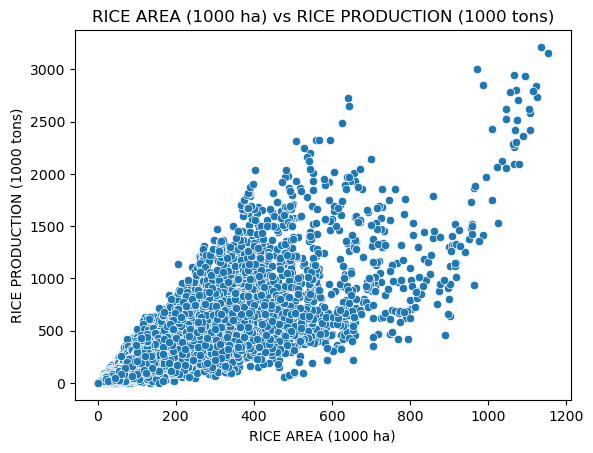

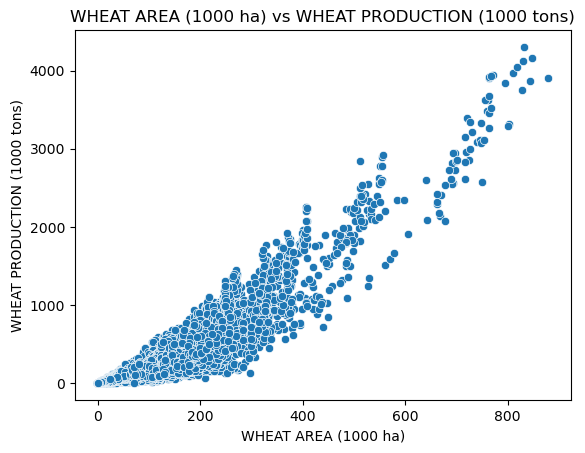

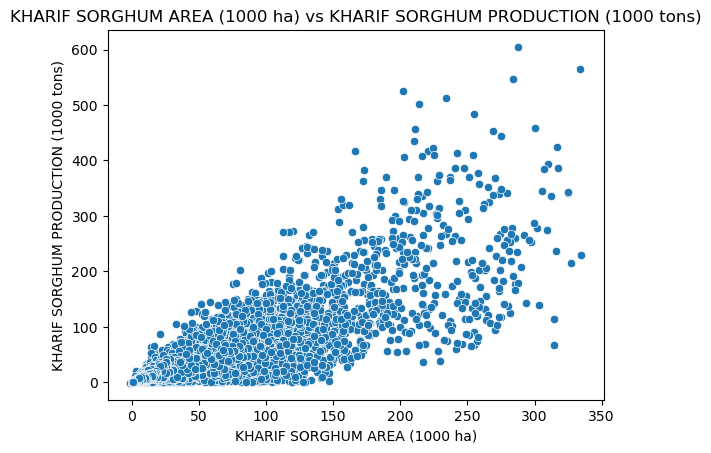

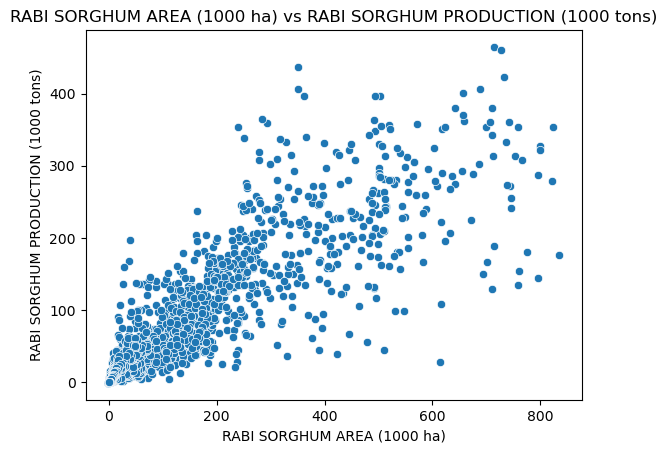

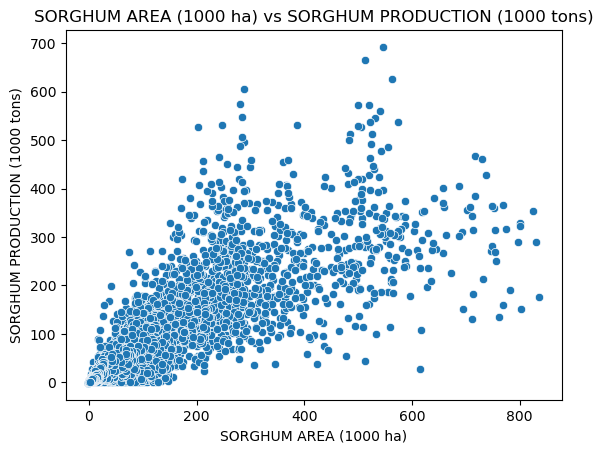

...

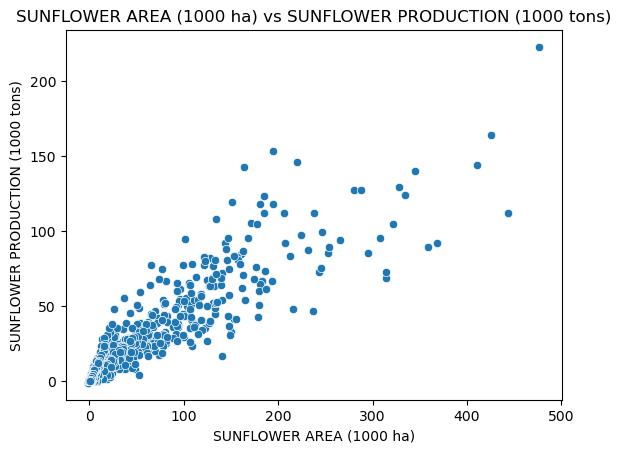

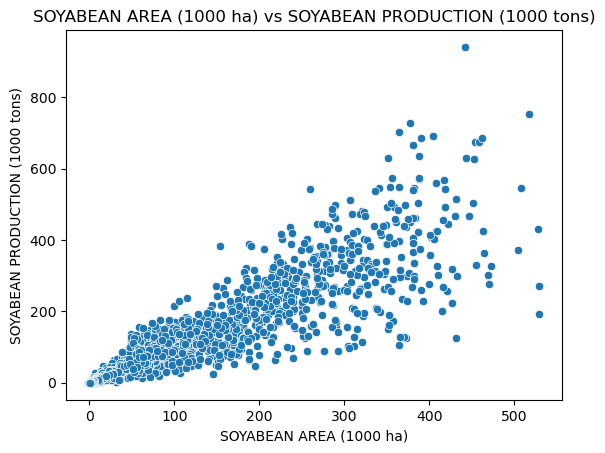

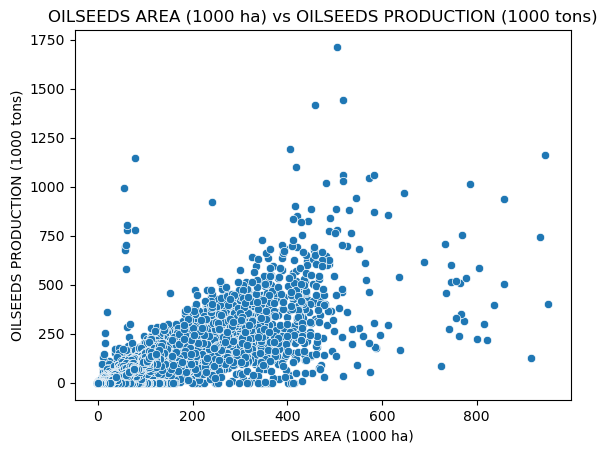

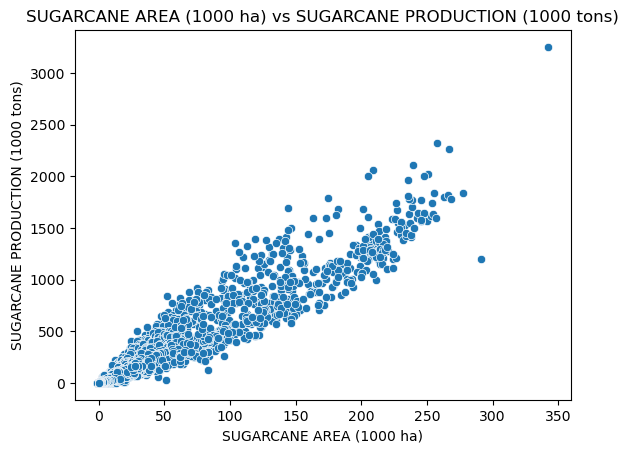

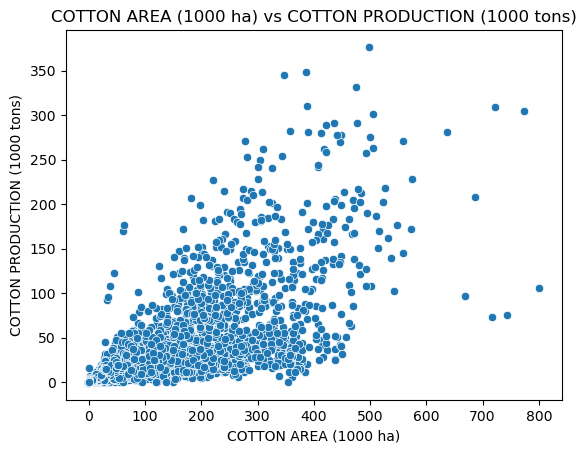

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter only columns with AREA, PRODUCTION, and YIELD
area_cols = [col for col in agri_df.columns if 'AREA' in col]
prod_cols = [col for col in agri_df.columns if 'PRODUCTION' in col]
yield_cols = [col for col in agri_df.columns if 'YIELD' in col]

# Check selected columns
print("Area Columns:", area_cols)
print("Production Columns:", prod_cols)
print("Yield Columns:", yield_cols)


# Plotting all Area vs Production columns
for area, prod in zip(area_cols, prod_cols):
    sns.scatterplot(data=agri_df, x=area, y=prod)
    plt.title(f"{area} vs {prod}")
    plt.xlabel(area)
    plt.ylabel(prod)
    plt.show()


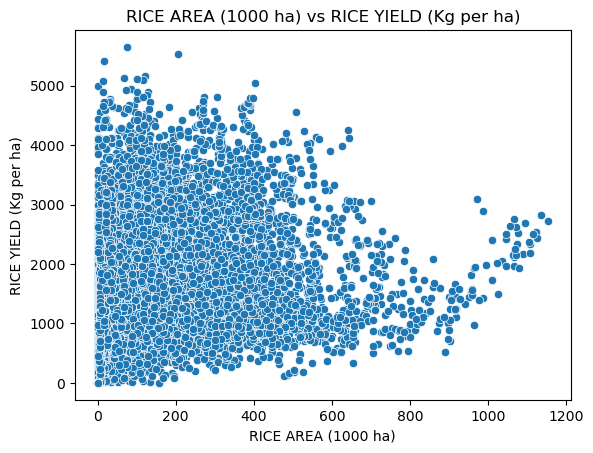

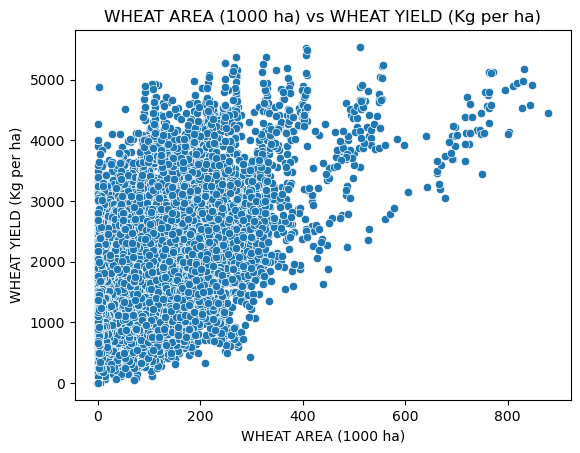

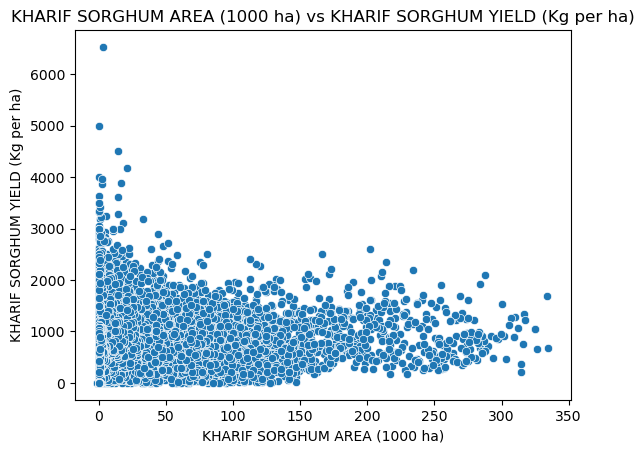

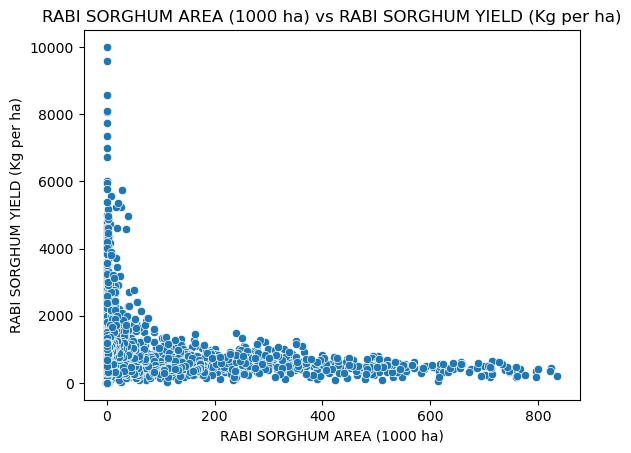

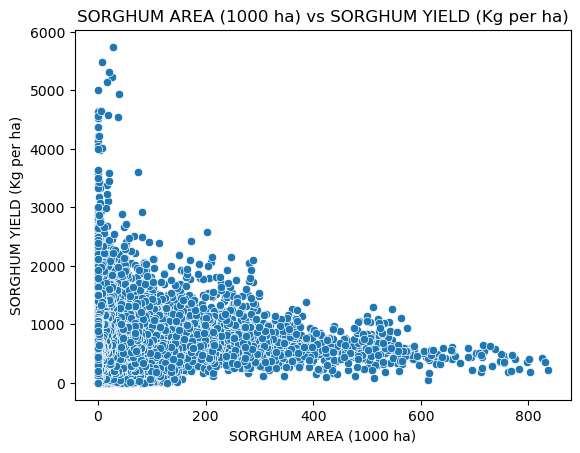

...

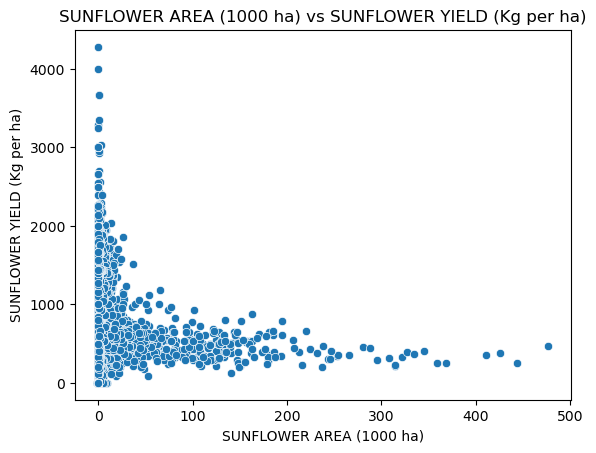

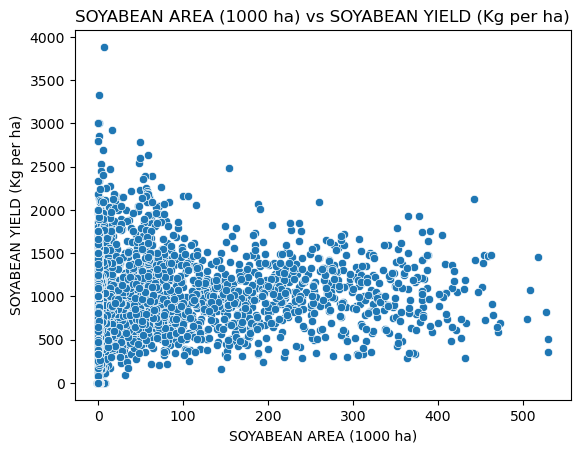

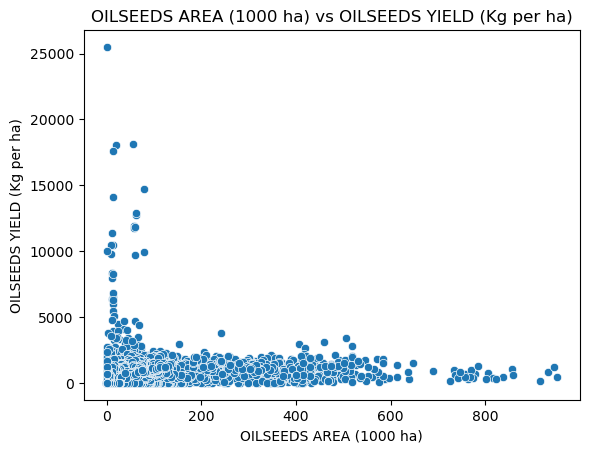

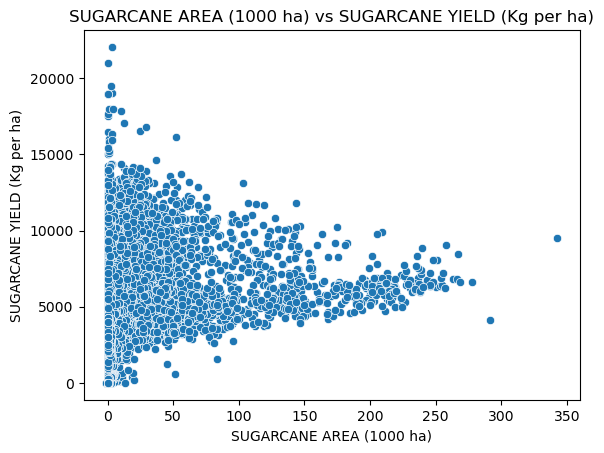

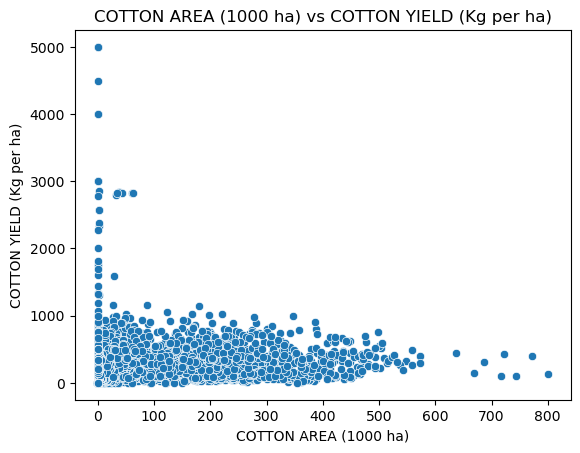

In [35]:
# Plotting all Area vs Yield columns
for area, yld in zip(area_cols, yield_cols):
    sns.scatterplot(data=agri_df, x=area, y=yld)
    plt.title(f"{area} vs {yld}")
    plt.xlabel(area)
    plt.ylabel(yld)
    plt.show()


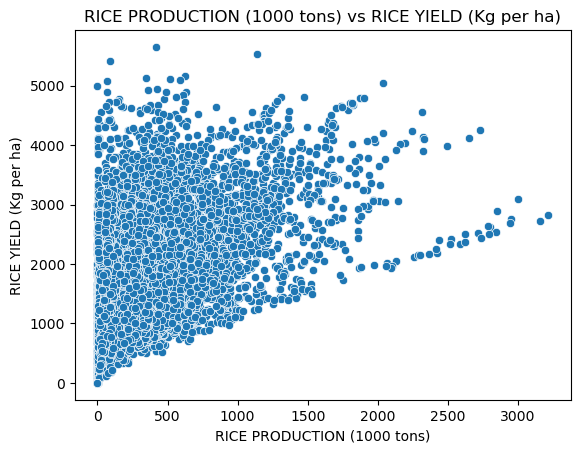

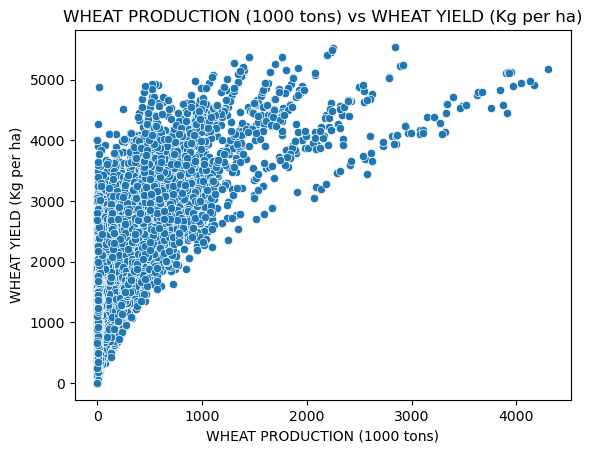

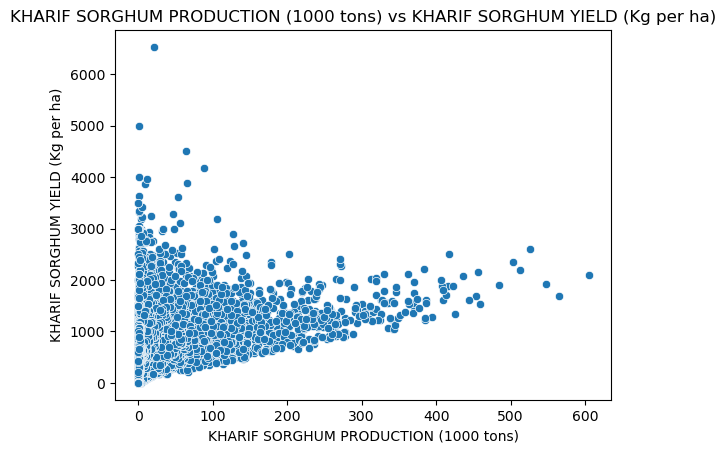

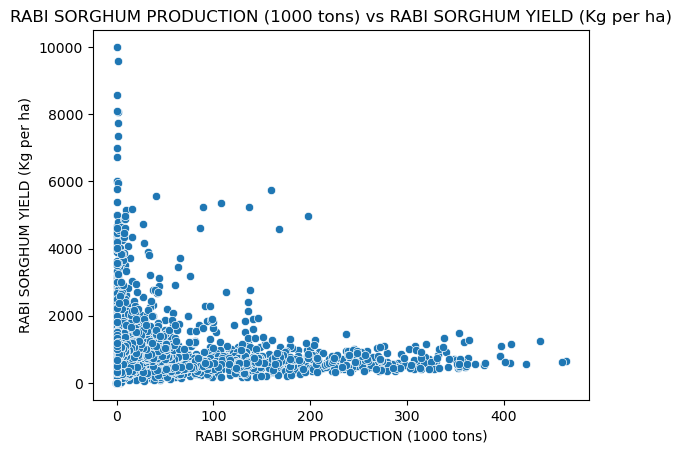

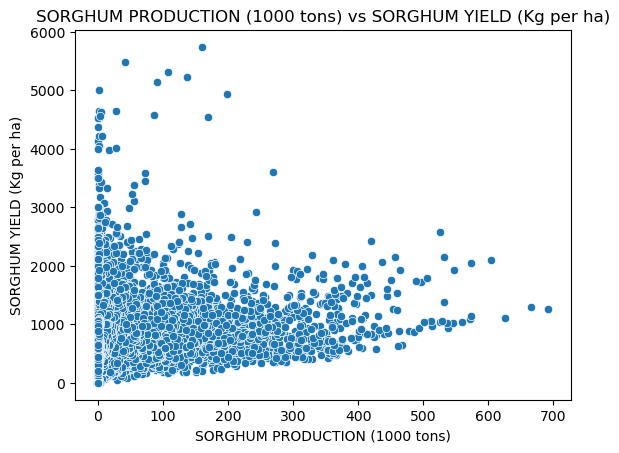

...

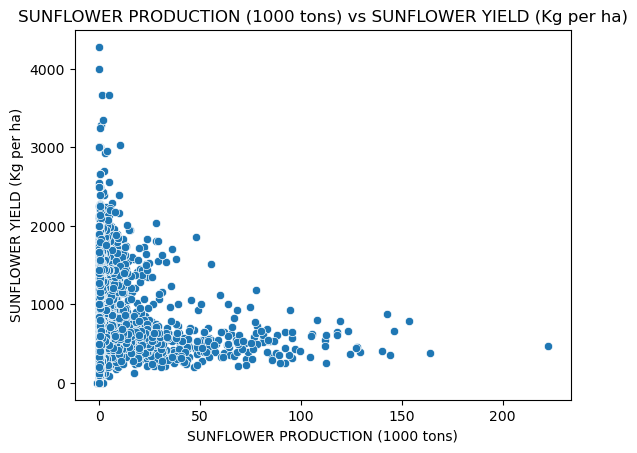

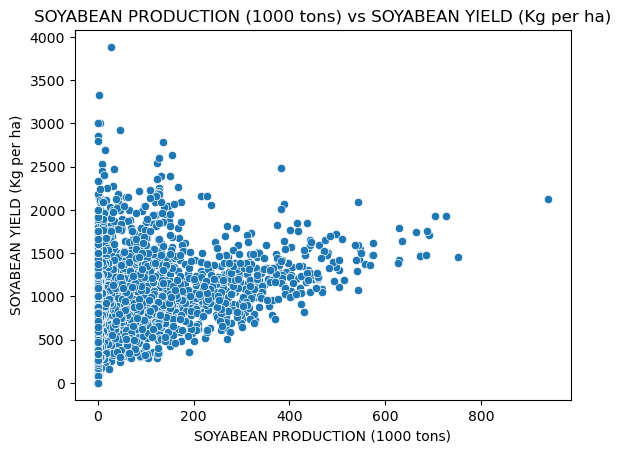

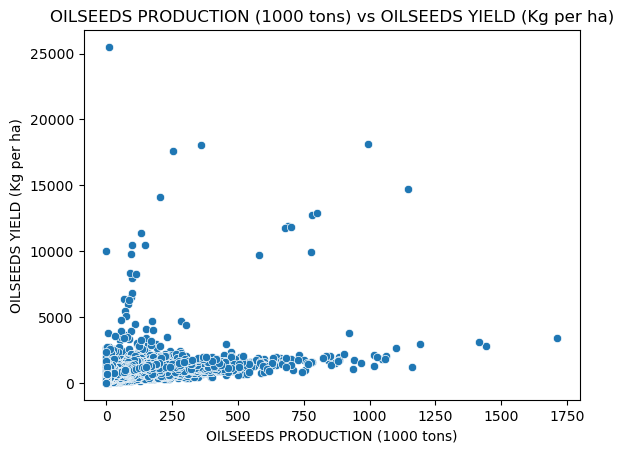

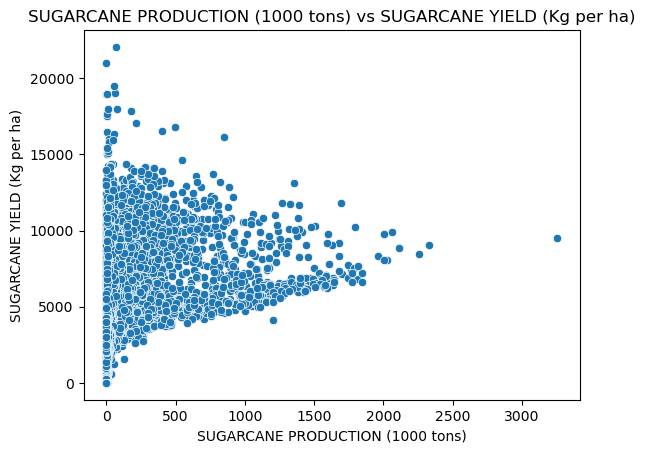

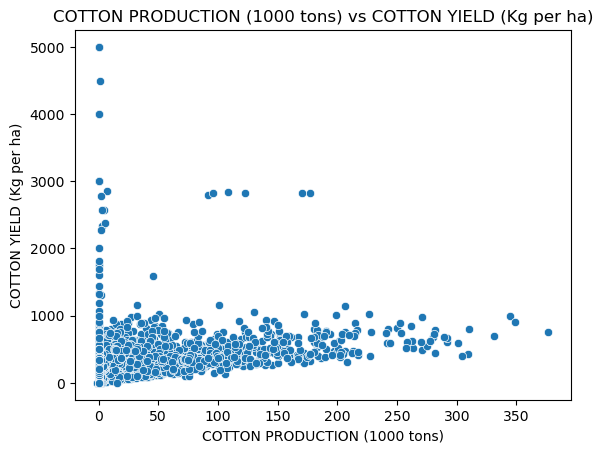

In [37]:
# Plotting all Production vs Yield columns
for prod, yld in zip(prod_cols, yield_cols):
    sns.scatterplot(data=agri_df, x=prod, y=yld)
    plt.title(f"{prod} vs {yld}")
    plt.xlabel(prod)
    plt.ylabel(yld)
    plt.show()

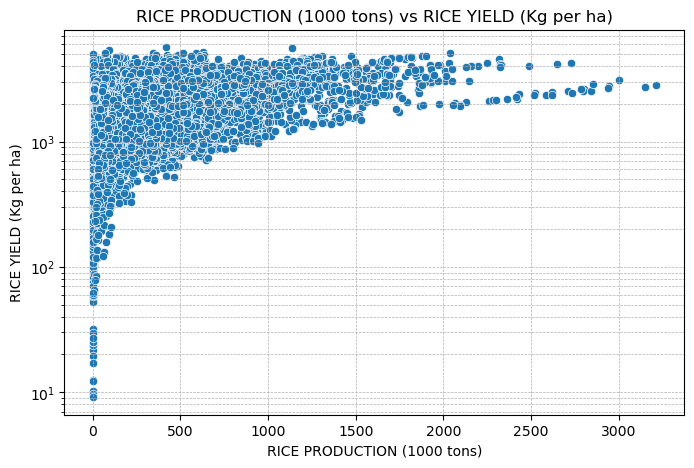

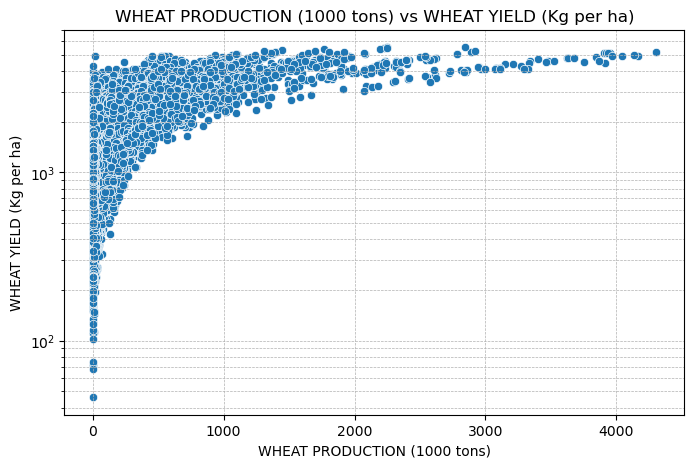

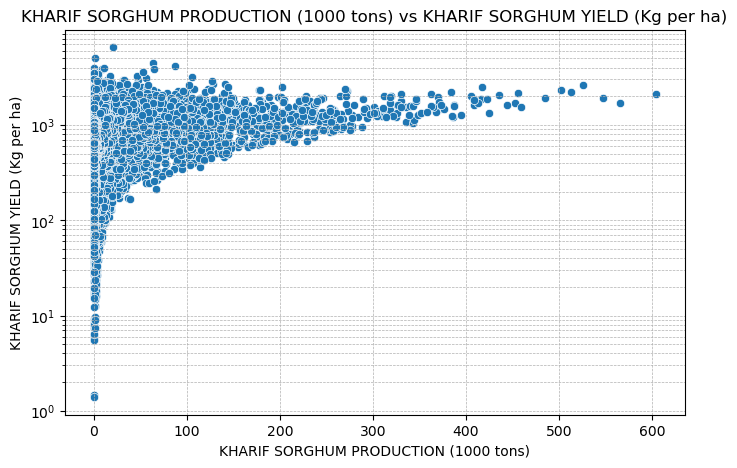

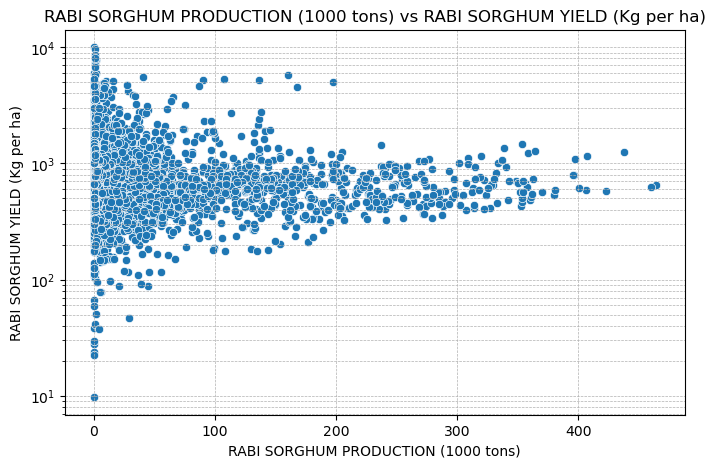

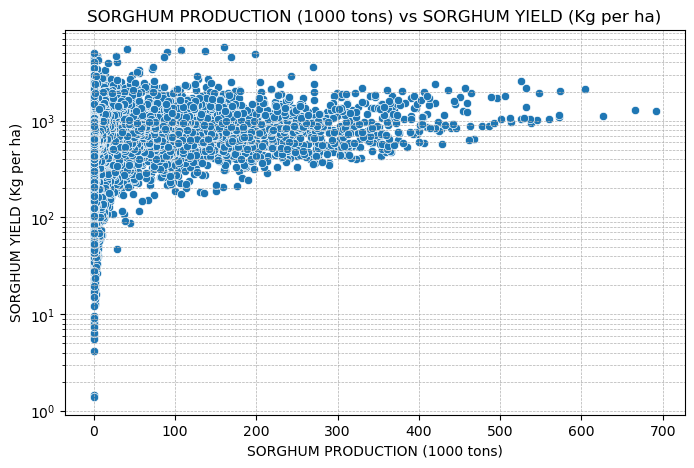

...

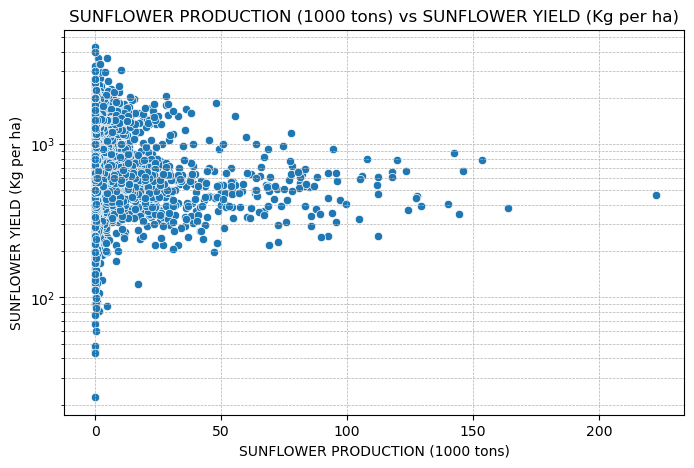

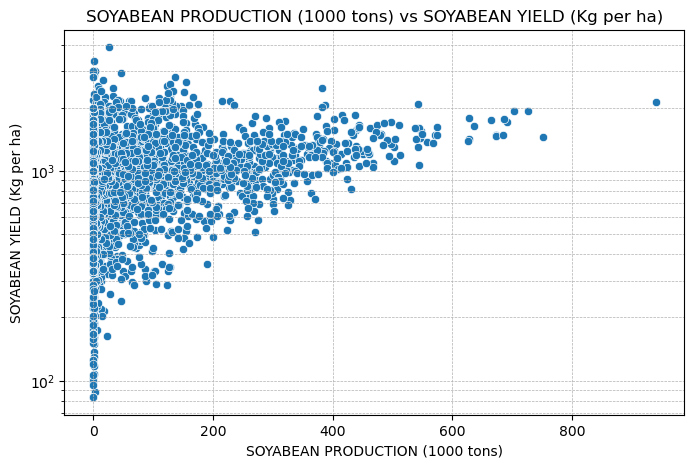

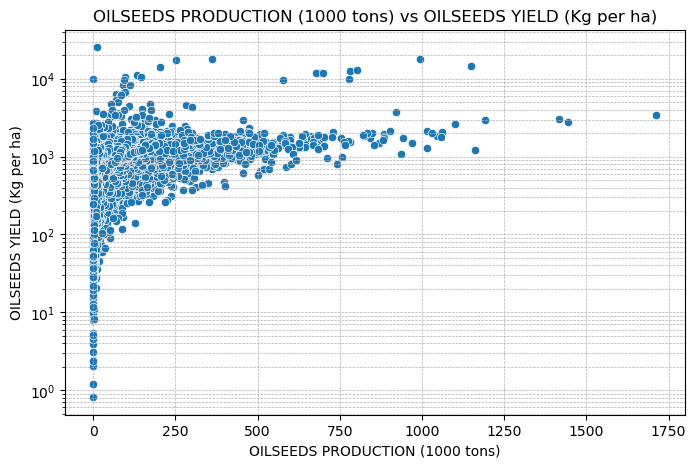

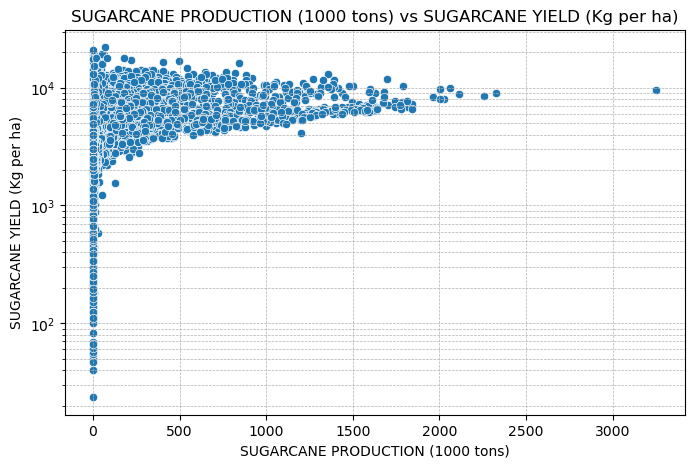

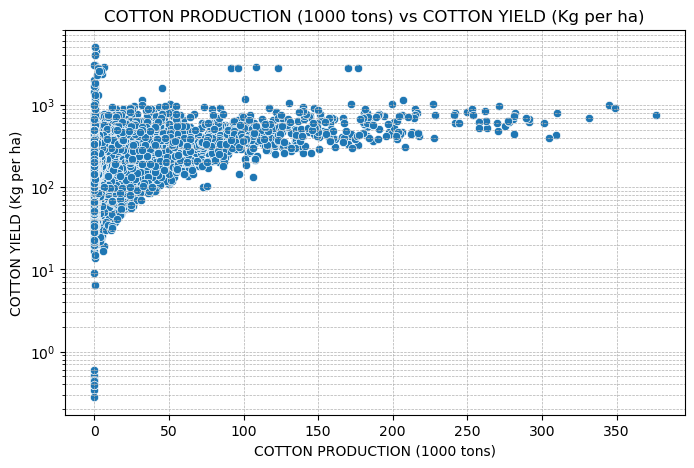

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plotting all Production vs Yield columns with log scale
for prod, yld in zip(prod_cols, yield_cols):
    plt.figure(figsize=(8, 5))
    sns.scatterplot(data=agri_df, x=prod, y=yld)
    
    plt.yscale('log')  # Apply log scale to yield for better visualization
    
    plt.title(f"{prod} vs {yld}")
    plt.xlabel(prod)
    plt.ylabel(yld)
    plt.grid(True, which="both", linestyle="--", linewidth=0.5)  # Optional grid for clarity
    plt.show()


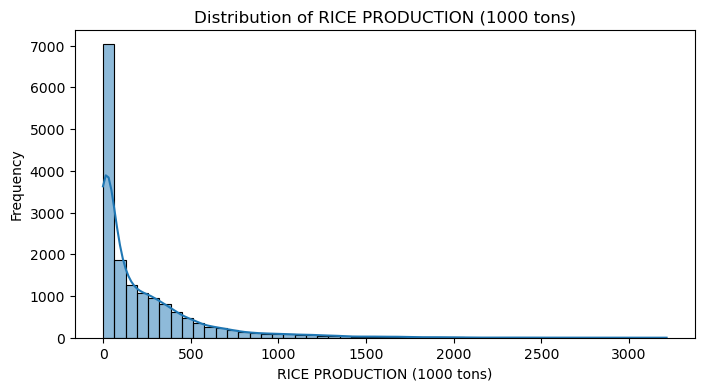

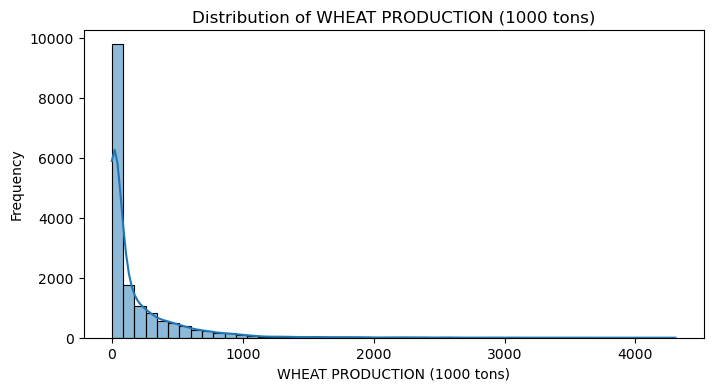

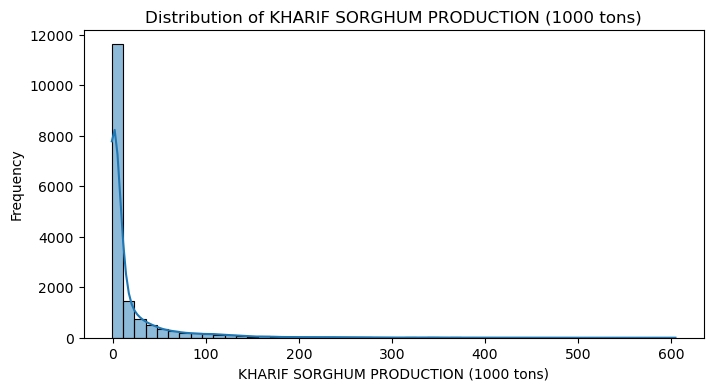

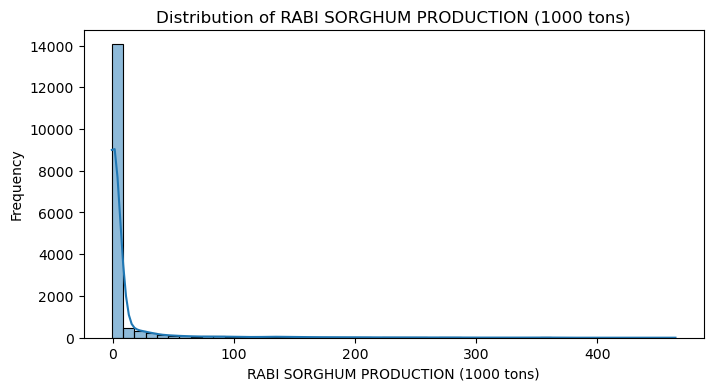

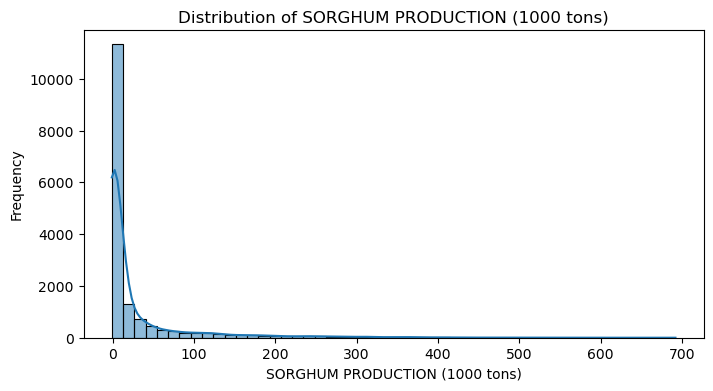

...

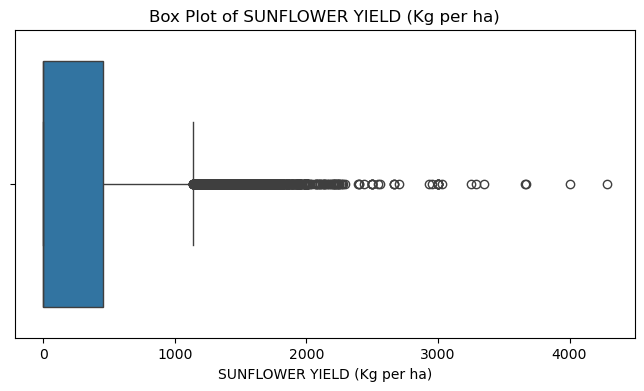

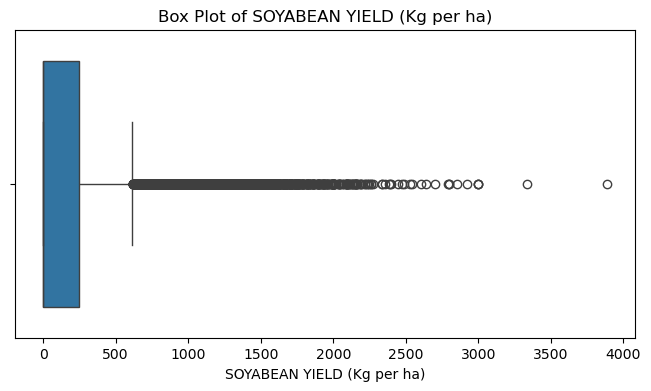

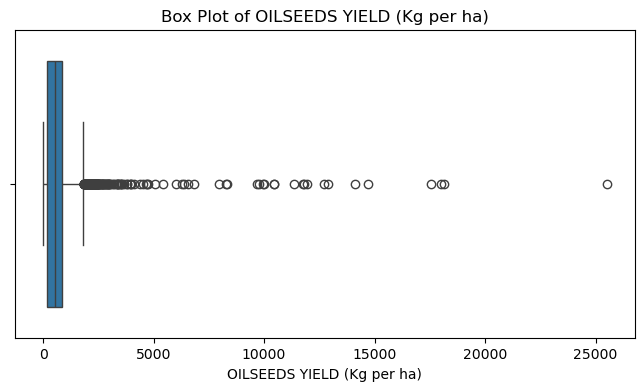

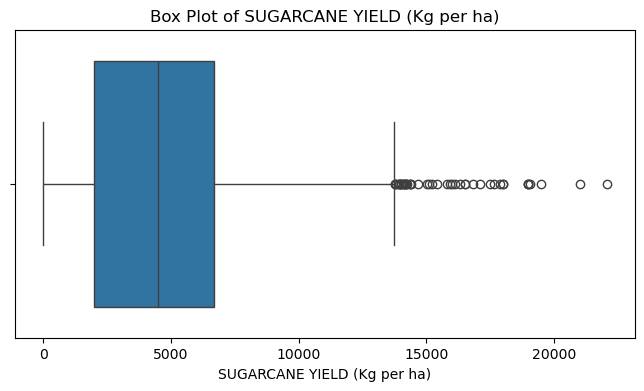

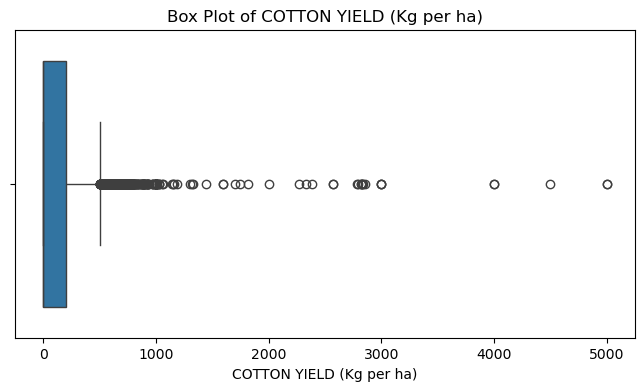

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot histograms for production and yield columns
for col in prod_cols + yield_cols:
    plt.figure(figsize=(8, 4))
    sns.histplot(agri_df[col], bins=50, kde=True)
    plt.title(f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.show()

# Plot box plots to detect outliers
for col in prod_cols + yield_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=agri_df[col])
    plt.title(f"Box Plot of {col}")
    plt.xlabel(col)
    plt.show()


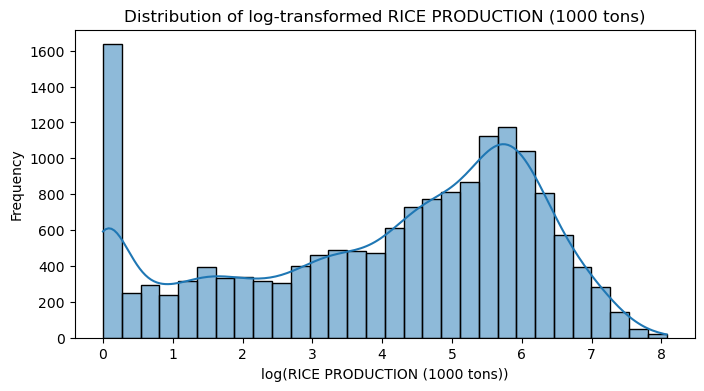

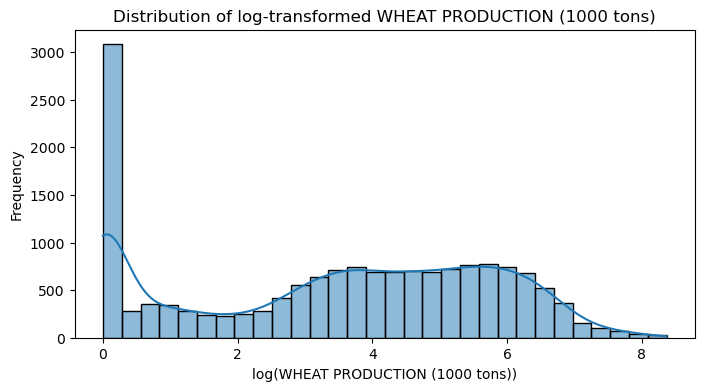

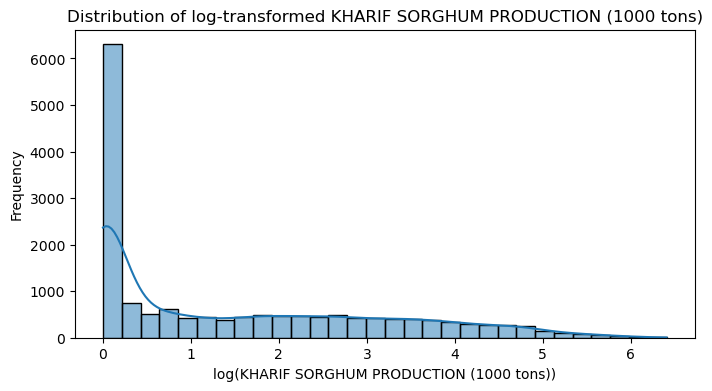

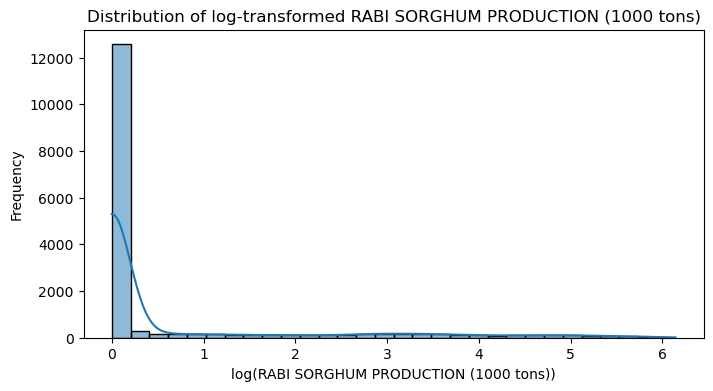

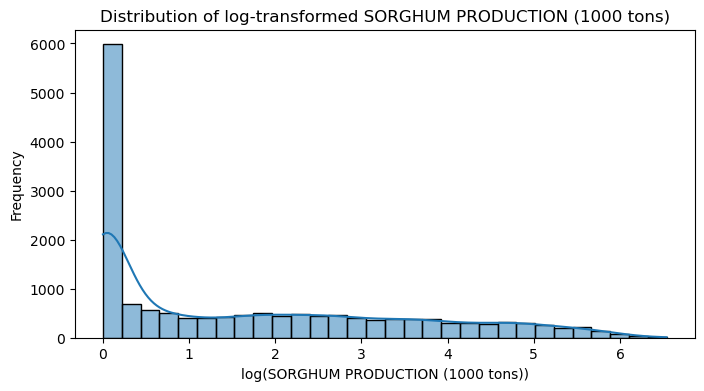

...

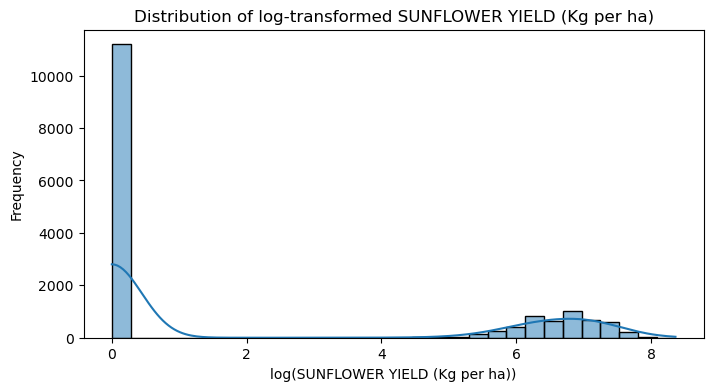

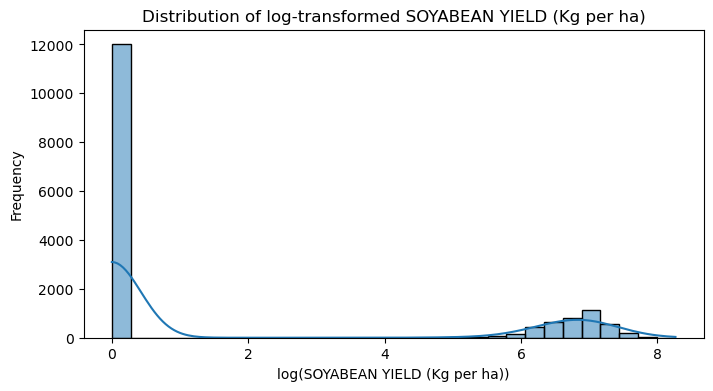

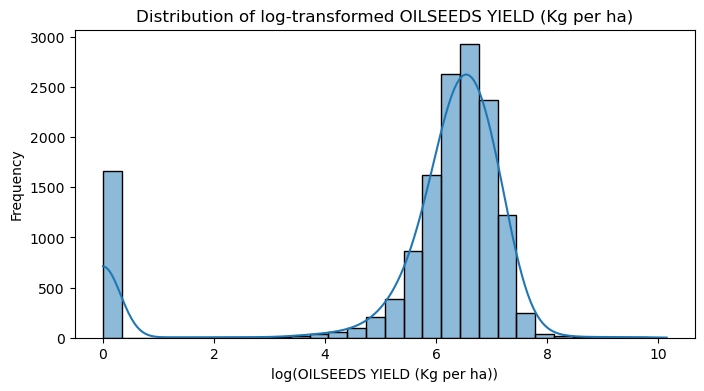

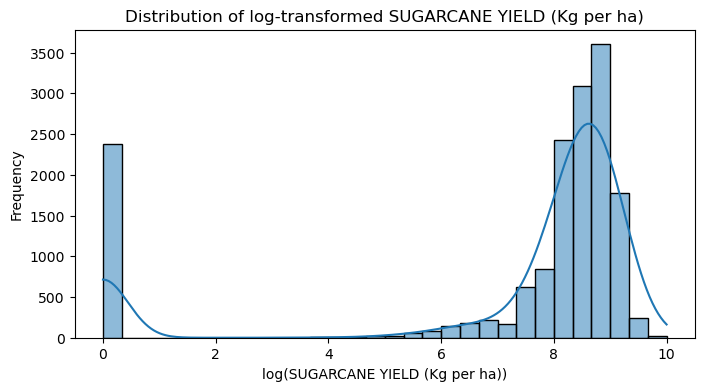

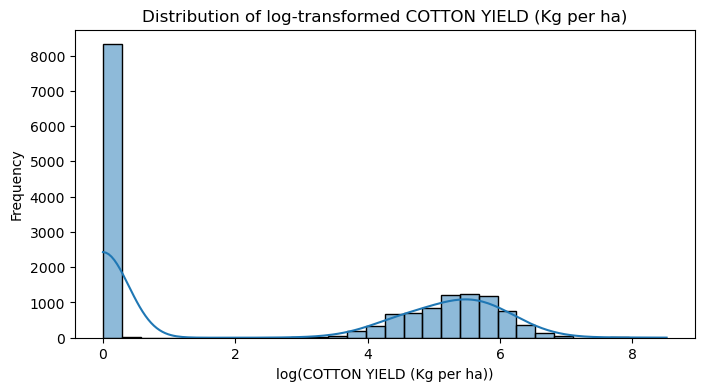

In [25]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Replace negative values with NaN before log transformation
for col in prod_cols + yield_cols:
    agri_df[f"log_{col}"] = np.log1p(agri_df[col].where(agri_df[col] >= 0, np.nan))

# Plot histograms to check distribution after transformation
for col in prod_cols + yield_cols:
    plt.figure(figsize=(8, 4))
    sns.histplot(agri_df[f"log_{col}"].dropna(), bins=30, kde=True)
    plt.title(f"Distribution of log-transformed {col}")
    plt.xlabel(f"log({col})")
    plt.ylabel("Frequency")
    plt.show()


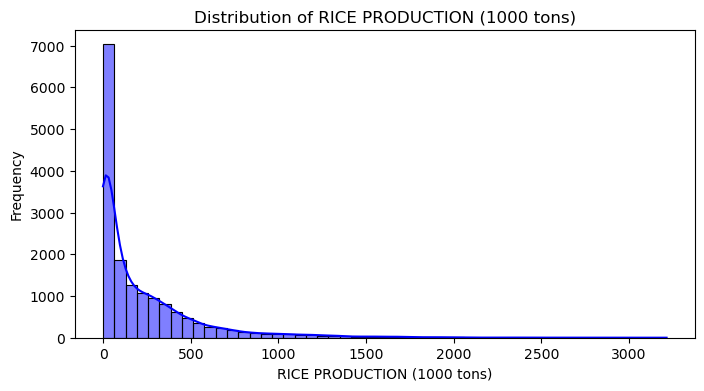

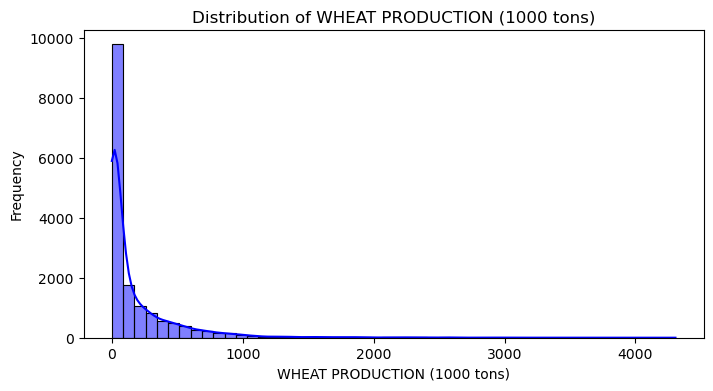

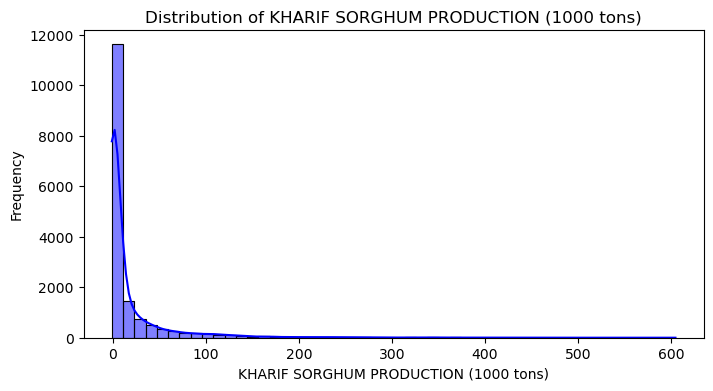

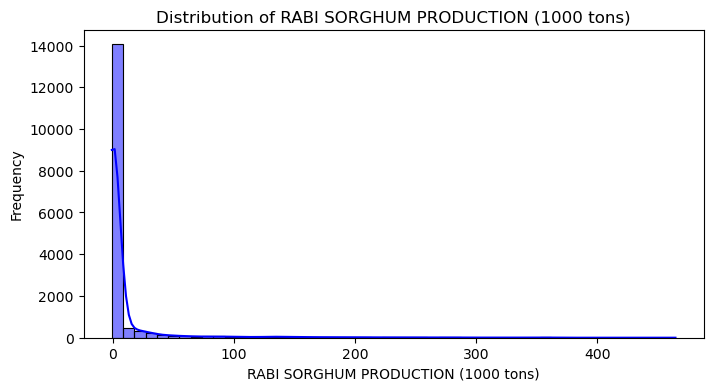

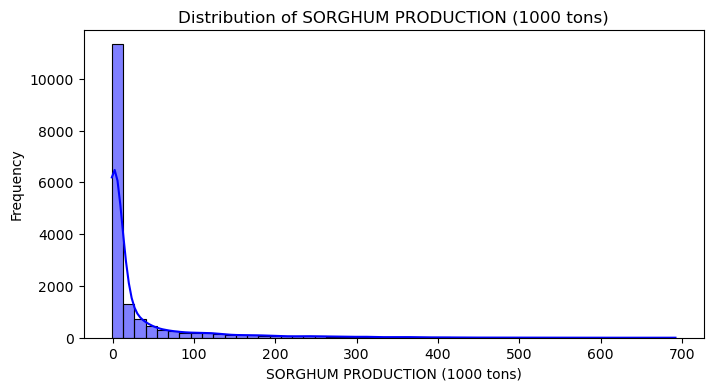

...

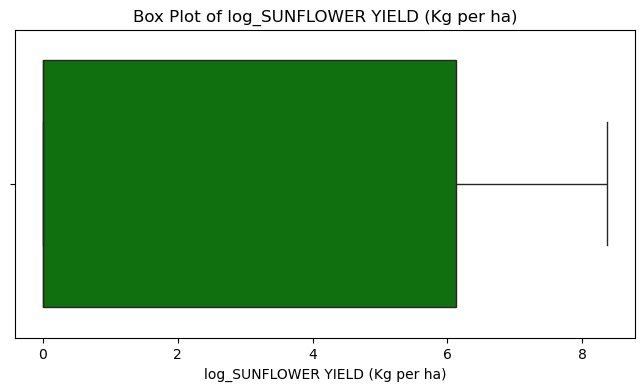

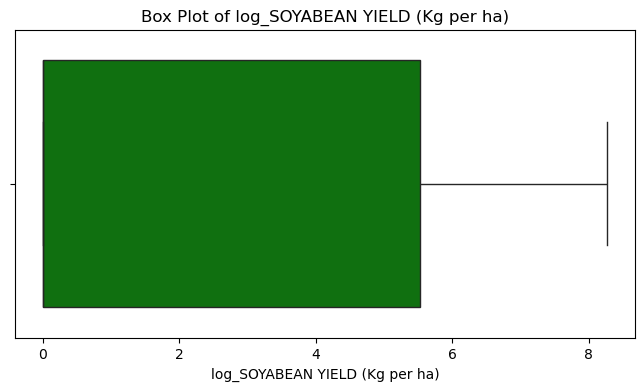

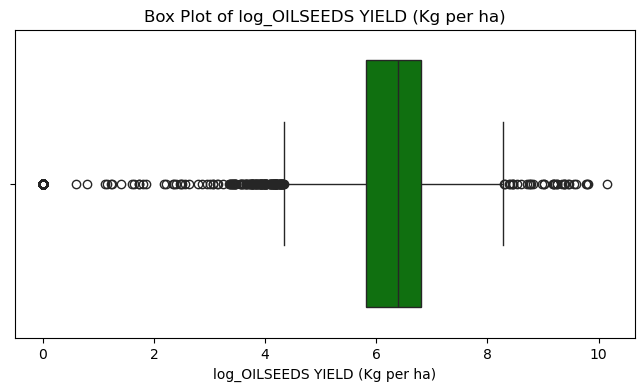

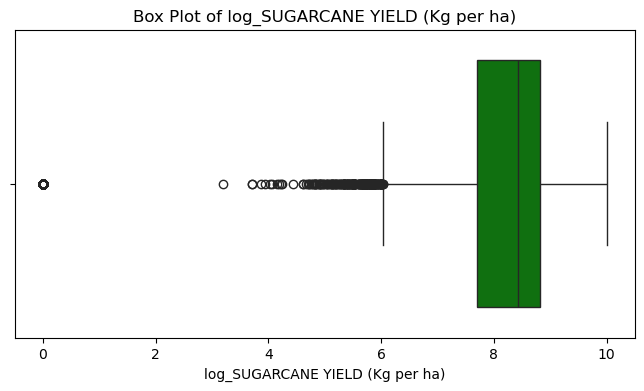

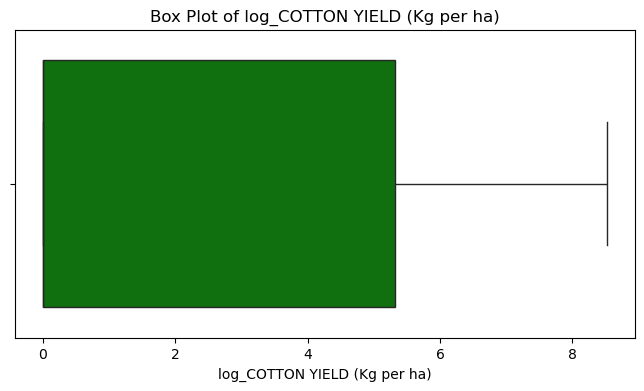

In [33]:
# Extract production and yield columns
prod_cols = [col for col in agri_df.columns if "PRODUCTION" in col]
yield_cols = [col for col in agri_df.columns if "YIELD" in col]

# Plot histograms for production and yield columns
for col in prod_cols + yield_cols:
    plt.figure(figsize=(8, 4))
    sns.histplot(agri_df[col], bins=50, kde=True, color="blue")
    plt.title(f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.show()

# Plot box plots to detect outliers
for col in prod_cols + yield_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=agri_df[col], color="green")
    plt.title(f"Box Plot of {col}")
    plt.xlabel(col)
    plt.show()

In [35]:
from scipy.stats import skew, kurtosis

# Compute skewness and kurtosis for production and yield columns
for col in prod_cols + yield_cols:
    col_skew = skew(agri_df[col], nan_policy='omit')
    col_kurt = kurtosis(agri_df[col], nan_policy='omit')
    
    print(f"{col}: Skewness = {col_skew:.4f}, Kurtosis = {col_kurt:.4f}")


RICE PRODUCTION (1000 tons): Skewness = 2.7495, Kurtosis = 10.7715
WHEAT PRODUCTION (1000 tons): Skewness = 4.4263, Kurtosis = 29.3571
KHARIF SORGHUM PRODUCTION (1000 tons): Skewness = 4.6619, Kurtosis = 29.5807
RABI SORGHUM PRODUCTION (1000 tons): Skewness = 5.6783, Kurtosis = 37.2425
SORGHUM PRODUCTION (1000 tons): Skewness = 3.6557, Kurtosis = 16.0750
PEARL MILLET PRODUCTION (1000 tons): Skewness = 4.9499, Kurtosis = 33.3442
MAIZE PRODUCTION (1000 tons): Skewness = 5.2715, Kurtosis = 42.6072
FINGER MILLET PRODUCTION (1000 tons): Skewness = 7.0153, Kurtosis = 61.1529
BARLEY PRODUCTION (1000 tons): Skewness = 6.4815, Kurtosis = 70.3938
CHICKPEA PRODUCTION (1000 tons): Skewness = 4.4605, Kurtosis = 29.9588
PIGEONPEA PRODUCTION (1000 tons): Skewness = 10.2558, Kurtosis = 209.8410
MINOR PULSES PRODUCTION (1000 tons): Skewness = 4.1656, Kurtosis = 27.8045
GROUNDNUT PRODUCTION (1000 tons): Skewness = 8.3228, Kurtosis = 105.5945
SESAMUM PRODUCTION (1000 tons): Skewness = 5.7317, Kurtosis = 

In [39]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler

# Identify numeric columns
numeric_cols = df.select_dtypes(include=['number']).columns

# Choose the method based on data distribution
min_max_scaler = MinMaxScaler()
standard_scaler = StandardScaler()
robust_scaler = RobustScaler()

# Check skewness only for numeric columns
skewness = df[numeric_cols].skew()

# Apply normalization based on skewness
df_scaled = df.copy()
for col in numeric_cols:
    if skewness[col] > 1 or skewness[col] < -1:
        df_scaled[col] = robust_scaler.fit_transform(df[[col]])
    else:
        df_scaled[col] = standard_scaler.fit_transform(df[[col]])

# Verify the result
print(df_scaled.describe())


          Dist Code          Year    State Code  RICE AREA (1000 ha)  \
count  16146.000000  1.614600e+04  1.614600e+04         16146.000000   
mean       0.697971  2.250976e-16  5.632941e-17             0.341418   
std        1.707418  1.000031e+00  1.000031e+00             0.884462   
min       -0.950920 -1.698576e+00 -1.717703e+00            -0.374606   
25%       -0.478528 -8.991468e-01 -7.153744e-01            -0.311619   
50%        0.000000 -3.309910e-02  8.648856e-02             0.000000   
75%        0.521472  8.995677e-01  4.874200e-01             0.688381   
max        4.668712  1.698996e+00  2.091146e+00             6.008232   

       RICE PRODUCTION (1000 tons)  RICE YIELD (Kg per ha)  \
count                 1.614600e+04            1.614600e+04   
mean                  4.213795e-01            7.041177e-18   
std                   1.066529e+00            1.000031e+00   
min                  -3.162071e-01           -1.556153e+00   
25%                  -2.820525e-01       

In [81]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv(r"C:\Jeeva\Course\csv_file\agri_capstone.csv")

# Ensure column names are correct
df.columns = df.columns.str.strip().str.lower()  # Standardize column names

df.columns = (
    df.columns.str.lower()  # Convert to lowercase
    .str.replace(r"[()]", "", regex=True)  # Remove parentheses
    .str.replace(r"\s+", "_", regex=True)  # Replace spaces with underscores
)

df.columns


Index(['dist_code', 'year', 'state_code', 'state_name', 'dist_name',
       'rice_area_1000_ha', 'rice_production_1000_tons',
       'rice_yield_kg_per_ha', 'wheat_area_1000_ha',
       'wheat_production_1000_tons', 'wheat_yield_kg_per_ha',
       'kharif_sorghum_area_1000_ha', 'kharif_sorghum_production_1000_tons',
       'kharif_sorghum_yield_kg_per_ha', 'rabi_sorghum_area_1000_ha',
       'rabi_sorghum_production_1000_tons', 'rabi_sorghum_yield_kg_per_ha',
       'sorghum_area_1000_ha', 'sorghum_production_1000_tons',
       'sorghum_yield_kg_per_ha', 'pearl_millet_area_1000_ha',
       'pearl_millet_production_1000_tons', 'pearl_millet_yield_kg_per_ha',
       'maize_area_1000_ha', 'maize_production_1000_tons',
       'maize_yield_kg_per_ha', 'finger_millet_area_1000_ha',
       'finger_millet_production_1000_tons', 'finger_millet_yield_kg_per_ha',
       'barley_area_1000_ha', 'barley_production_1000_tons',
       'barley_yield_kg_per_ha', 'chickpea_area_1000_ha',
       'chickpea

In [83]:
# List of columns to drop (since they lack production and yield data)
cols_to_drop = [
    "fruits_area_1000_ha",
    "vegetables_area_1000_ha",
    "fruits_and_vegetables_area_1000_ha",
    "potatoes_area_1000_ha",
    "onion_area_1000_ha",
    "fodder_area_1000_ha"
]

# Drop them from the DataFrame
df = df.drop(columns=cols_to_drop, errors="ignore") 

df.columns

Index(['dist_code', 'year', 'state_code', 'state_name', 'dist_name',
       'rice_area_1000_ha', 'rice_production_1000_tons',
       'rice_yield_kg_per_ha', 'wheat_area_1000_ha',
       'wheat_production_1000_tons', 'wheat_yield_kg_per_ha',
       'kharif_sorghum_area_1000_ha', 'kharif_sorghum_production_1000_tons',
       'kharif_sorghum_yield_kg_per_ha', 'rabi_sorghum_area_1000_ha',
       'rabi_sorghum_production_1000_tons', 'rabi_sorghum_yield_kg_per_ha',
       'sorghum_area_1000_ha', 'sorghum_production_1000_tons',
       'sorghum_yield_kg_per_ha', 'pearl_millet_area_1000_ha',
       'pearl_millet_production_1000_tons', 'pearl_millet_yield_kg_per_ha',
       'maize_area_1000_ha', 'maize_production_1000_tons',
       'maize_yield_kg_per_ha', 'finger_millet_area_1000_ha',
       'finger_millet_production_1000_tons', 'finger_millet_yield_kg_per_ha',
       'barley_area_1000_ha', 'barley_production_1000_tons',
       'barley_yield_kg_per_ha', 'chickpea_area_1000_ha',
       'chickpea

In [85]:
# Additional renaming for crop-related columns
df.columns = df.columns.str.replace("_area_1000_ha", "_crop_area", regex=True)
df.columns = df.columns.str.replace("_production_1000_tons", "_crop_production", regex=True)
df.columns = df.columns.str.replace("_yield_kg_per_ha", "_crop_yield", regex=True)


df.columns

Index(['dist_code', 'year', 'state_code', 'state_name', 'dist_name',
       'rice_crop_area', 'rice_crop_production', 'rice_crop_yield',
       'wheat_crop_area', 'wheat_crop_production', 'wheat_crop_yield',
       'kharif_sorghum_crop_area', 'kharif_sorghum_crop_production',
       'kharif_sorghum_crop_yield', 'rabi_sorghum_crop_area',
       'rabi_sorghum_crop_production', 'rabi_sorghum_crop_yield',
       'sorghum_crop_area', 'sorghum_crop_production', 'sorghum_crop_yield',
       'pearl_millet_crop_area', 'pearl_millet_crop_production',
       'pearl_millet_crop_yield', 'maize_crop_area', 'maize_crop_production',
       'maize_crop_yield', 'finger_millet_crop_area',
       'finger_millet_crop_production', 'finger_millet_crop_yield',
       'barley_crop_area', 'barley_crop_production', 'barley_crop_yield',
       'chickpea_crop_area', 'chickpea_crop_production', 'chickpea_crop_yield',
       'pigeonpea_crop_area', 'pigeonpea_crop_production',
       'pigeonpea_crop_yield', 'minor_pu

In [91]:
# Define the common columns that should be retained in every crop DataFrame
common_columns = {"dist_code", "year", "state_code", "state_name", "dist_name"}

# Identify unique crop names dynamically (remove common columns)
crop_names = set(col.split("_crop_")[0] for col in df.columns if "_crop_" in col)

# Dictionary to store DataFrames for each crop
crop_dfs = {}

for crop in crop_names:
    # Select common columns + the current crop's specific columns
    crop_columns = list(common_columns) + [f"{crop}_crop_area", f"{crop}_crop_production", f"{crop}_crop_yield"]

    # Ensure the required columns exist in the DataFrame before filtering
    existing_columns = [col for col in crop_columns if col in df.columns]

    # Create a new DataFrame for the current crop
    crop_dfs[crop] = df[existing_columns].copy()

# Now crop_dfs dictionary contains separate DataFrames for each crop
print(crop_dfs["sugarcane"])  # See the DataFrame for rice


         state_name  dist_code  year  dist_name  state_code  \
0      Chhattisgarh          1  1966       Durg          14   
1      Chhattisgarh          1  1967       Durg          14   
2      Chhattisgarh          1  1968       Durg          14   
3      Chhattisgarh          1  1969       Durg          14   
4      Chhattisgarh          1  1970       Durg          14   
...             ...        ...   ...        ...         ...   
16141     Jharkhand        917  2013  Singhbhum          15   
16142     Jharkhand        917  2014  Singhbhum          15   
16143     Jharkhand        917  2015  Singhbhum          15   
16144     Jharkhand        917  2016  Singhbhum          15   
16145     Jharkhand        917  2017  Singhbhum          15   

       sugarcane_crop_area  sugarcane_crop_production  sugarcane_crop_yield  
0                      0.9                        1.6               1777.78  
1                      0.8                        1.2               1500.00  
2        

In [101]:
for crop, crop_df in crop_dfs.items():
    zero_mask = (crop_df[f"{crop}_crop_area"] == 0) & \
                (crop_df[f"{crop}_crop_production"] == 0) & \
                (crop_df[f"{crop}_crop_yield"] == 0)
    
    zero_count = zero_mask.sum()
    
    print(f"Crop: {crop}, Zero Rows: {zero_count}")

Crop: wheat, Zero Rows: 2283
Crop: sorghum, Zero Rows: 4234
Crop: rice, Zero Rows: 1079
Crop: kharif_sorghum, Zero Rows: 4520
Crop: barley, Zero Rows: 8033
Crop: rapeseed_and_mustard, Zero Rows: 3744
Crop: pearl_millet, Zero Rows: 5817
Crop: sugarcane, Zero Rows: 2028
Crop: linseed, Zero Rows: 8314
Crop: pigeonpea, Zero Rows: 2790
Crop: finger_millet, Zero Rows: 9958
Crop: groundnut, Zero Rows: 3748
Crop: safflower, Zero Rows: 12571
Crop: minor_pulses, Zero Rows: 552
Crop: maize, Zero Rows: 1792
Crop: sunflower, Zero Rows: 10863
Crop: sesamum, Zero Rows: 1801
Crop: oilseeds, Zero Rows: 1184
Crop: rabi_sorghum, Zero Rows: 11999
Crop: soyabean, Zero Rows: 11735
Crop: chickpea, Zero Rows: 1956
Crop: cotton, Zero Rows: 7341
Crop: castor, Zero Rows: 10231


In [99]:
for crop in unique_crops:
    area_col = f"{crop}_crop_area"
    prod_col = f"{crop}_crop_production"
    yield_col = f"{crop}_crop_yield"

    if area_col in df.columns and prod_col in df.columns and yield_col in df.columns:
        df = df[~((df[area_col] == 0) & (df[prod_col] == 0) & (df[yield_col] == 0))]

In [97]:
for crop, crop_df in crop_dfs.items():
    zero_mask = (crop_df[f"{crop}_crop_area"] == 0) & \
                (crop_df[f"{crop}_crop_production"] == 0) & \
                (crop_df[f"{crop}_crop_yield"] == 0)
    
    zero_count = zero_mask.sum()
    
    print(f"Crop: {crop}, Zero Rows: {zero_count}")

Crop: wheat, Zero Rows: 2283
Crop: sorghum, Zero Rows: 4234
Crop: rice, Zero Rows: 1079
Crop: kharif_sorghum, Zero Rows: 4520
Crop: barley, Zero Rows: 8033
Crop: rapeseed_and_mustard, Zero Rows: 3744
Crop: pearl_millet, Zero Rows: 5817
Crop: sugarcane, Zero Rows: 2028
Crop: linseed, Zero Rows: 8314
Crop: pigeonpea, Zero Rows: 2790
Crop: finger_millet, Zero Rows: 9958
Crop: groundnut, Zero Rows: 3748
Crop: safflower, Zero Rows: 12571
Crop: minor_pulses, Zero Rows: 552
Crop: maize, Zero Rows: 1792
Crop: sunflower, Zero Rows: 10863
Crop: sesamum, Zero Rows: 1801
Crop: oilseeds, Zero Rows: 1184
Crop: rabi_sorghum, Zero Rows: 11999
Crop: soyabean, Zero Rows: 11735
Crop: chickpea, Zero Rows: 1956
Crop: cotton, Zero Rows: 7341
Crop: castor, Zero Rows: 10231


In [69]:
with pd.ExcelWriter(output_file, engine="openpyxl") as writer:
    sheet_created = False  # Track if any sheet is created
    for crop in unique_crops:
        area_col = f"{crop}_area_1000_ha"
        prod_col = f"{crop}_production_1000_tons"
        yield_col = f"{crop}_yield_kg_per_ha"

        if area_col in df.columns and prod_col in df.columns and yield_col in df.columns:
            crop_df = df[["dist_code", "year", "state_code", "state_name", "dist_name", area_col, prod_col, yield_col]].copy()
            crop_df = crop_df[~((crop_df[area_col] == 0) & (crop_df[prod_col] == 0) & (crop_df[yield_col] == 0))]

            if not crop_df.empty:  # Save only if DataFrame is not empty
                crop_df.to_excel(writer, sheet_name=crop, index=False)
                sheet_created = True

    if not sheet_created:  # If no sheets, create an empty dummy sheet
        pd.DataFrame({"Message": ["No valid crop data available"]}).to_excel(writer, sheet_name="No_Data", index=False)

print(f"All crop data saved in {output_file}.")


All crop data saved in crop_data_separated.xlsx.


In [1]:
#connecting with database
import pymysql
my_db_connection = pymysql.connect(host = "127.0.0.1",user="root",passwd='Tr@de2win')

In [41]:
# Mapping of Pandas dtypes to SQL types
dtype_mapping = {
    "int64": "INT",
    "float64": "FLOAT",
    "object": "VARCHAR(255)"
}

# Generate column definitions dynamically with new lines
columns_sql = []
for col, dtype in df.dtypes.items():
    sql_type = dtype_mapping.get(str(dtype), "VARCHAR(255)")  # Default to VARCHAR
    columns_sql.append(f"    {col} {sql_type}")  # Indentation for formatting

# Create SQL command with properly formatted new lines
create_table_query = f"""
CREATE TABLE raw_crop_data (
{",\n".join(columns_sql)}
);
"""

print(create_table_query)  # Verify formatted SQL query
my_db_connection.cursor().execute("USE agri_capstone")
my_db_connection.cursor().execute(create_table_query)


CREATE TABLE raw_crop_data (
    dist_code INT,
    year INT,
    state_code INT,
    state_name VARCHAR(255),
    dist_name VARCHAR(255),
    rice_area_1000_ha FLOAT,
    rice_production_1000_tons FLOAT,
    rice_yield_kg_per_ha FLOAT,
    wheat_area_1000_ha FLOAT,
    wheat_production_1000_tons FLOAT,
    wheat_yield_kg_per_ha FLOAT,
    kharif_sorghum_area_1000_ha FLOAT,
    kharif_sorghum_production_1000_tons FLOAT,
    kharif_sorghum_yield_kg_per_ha FLOAT,
    rabi_sorghum_area_1000_ha FLOAT,
    rabi_sorghum_production_1000_tons FLOAT,
    rabi_sorghum_yield_kg_per_ha FLOAT,
    sorghum_area_1000_ha FLOAT,
    sorghum_production_1000_tons FLOAT,
    sorghum_yield_kg_per_ha FLOAT,
    pearl_millet_area_1000_ha FLOAT,
    pearl_millet_production_1000_tons FLOAT,
    pearl_millet_yield_kg_per_ha FLOAT,
    maize_area_1000_ha FLOAT,
    maize_production_1000_tons FLOAT,
    maize_yield_kg_per_ha FLOAT,
    finger_millet_area_1000_ha FLOAT,
    finger_millet_production_1000_tons FLOA

0

In [45]:
import pymysql  # Ensure you have the correct DB library
import numpy as np

table_name = "raw_crop_data"  
database_name = "agri_capstone"

# Create SQL query dynamically based on column count
num_cols = len(df.columns)
placeholders = ", ".join(["%s"] * num_cols)
insert_query = f"INSERT INTO {database_name}.{table_name} VALUES ({placeholders})"

# Convert DataFrame to list of tuples (handling NaN values)
data = [tuple(None if pd.isna(val) else val for val in row) for row in df.itertuples(index=False)]

# Execute batch insertion
cursor = my_db_connection.cursor()
cursor.executemany(insert_query, data)

my_db_connection.commit()
print(f"Rows Inserted: {cursor.rowcount}")  # Shows number of rows inserted
cursor.close()


Rows Inserted: 16146
